<a href="https://colab.research.google.com/github/daecgu/Leet-Code-Easy/blob/main/vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

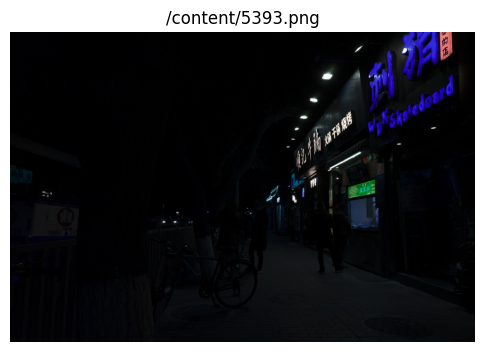

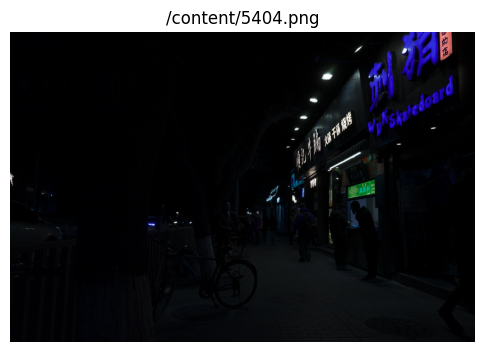

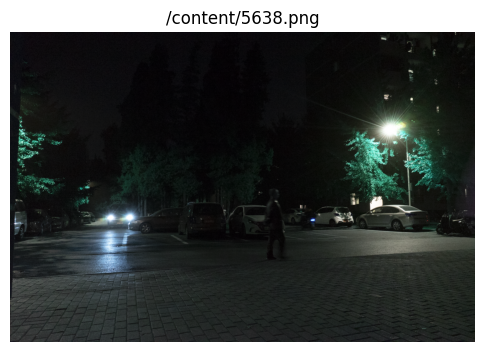

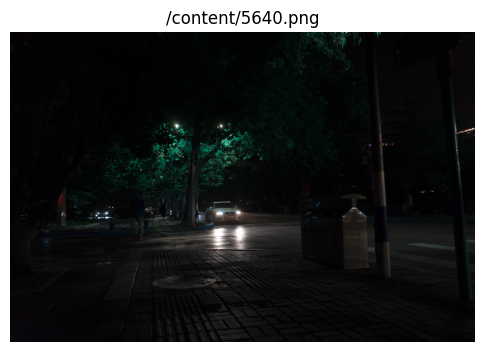

In [ ]:
# Importar librerías necesarias
import cv2
import numpy as np
from matplotlib import pyplot as plt
from skimage import exposure

# Función para cargar y mostrar imágenes
def load_and_display_image(path):
    # b/n
    # image = cv2.imread(path, cv2.IMREAD_GRAYSCALE)

    # COLOR
    image = cv2.imread(path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    plt.title(path)
    plt.axis('off')
    plt.show()
    return image

# Cargar y mostrar las imágenes
image_paths = ["/content/5393.png", "/content/5404.png", "/content/5638.png", "/content/5640.png"]
images = [load_and_display_image(path) for path in image_paths]


<ipython-input-3-7419f102667e>:8: RuntimeWarning: divide by zero encountered in log
  log_image = c * (np.log(image + 1))
<ipython-input-3-7419f102667e>:9: RuntimeWarning: invalid value encountered in cast
  log_image = np.array(log_image, dtype=np.uint8)


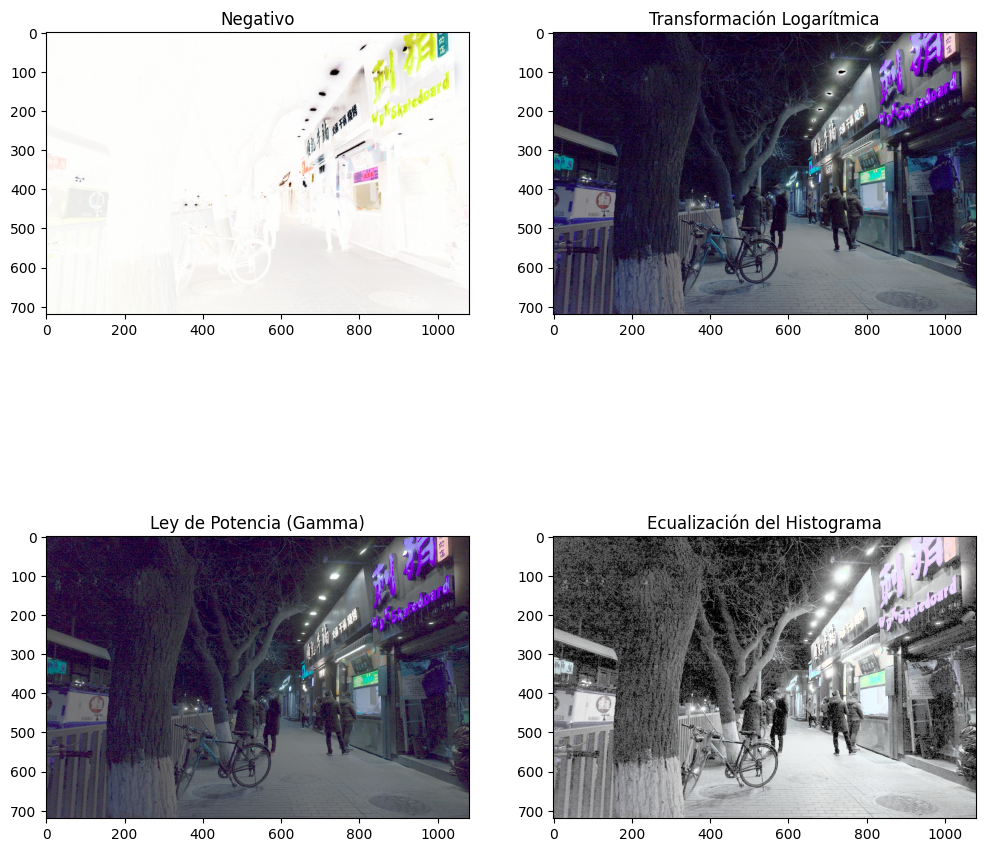

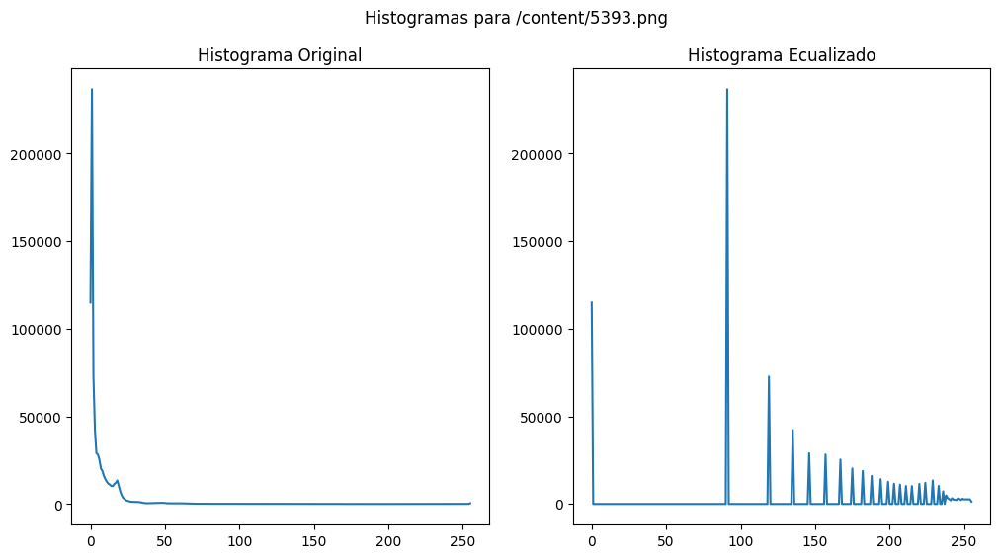

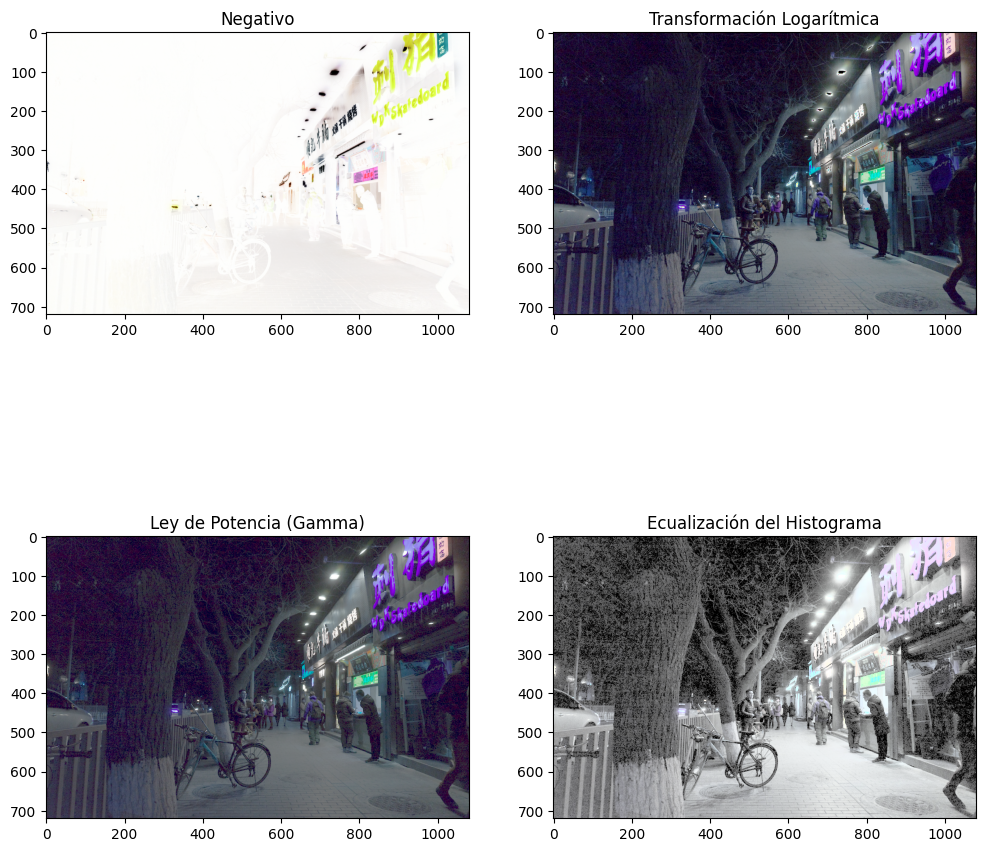

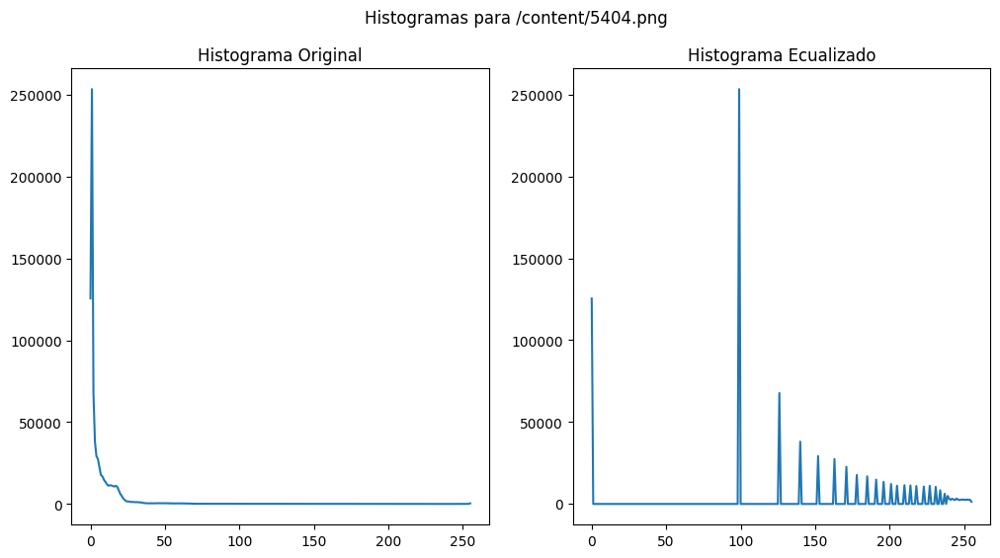

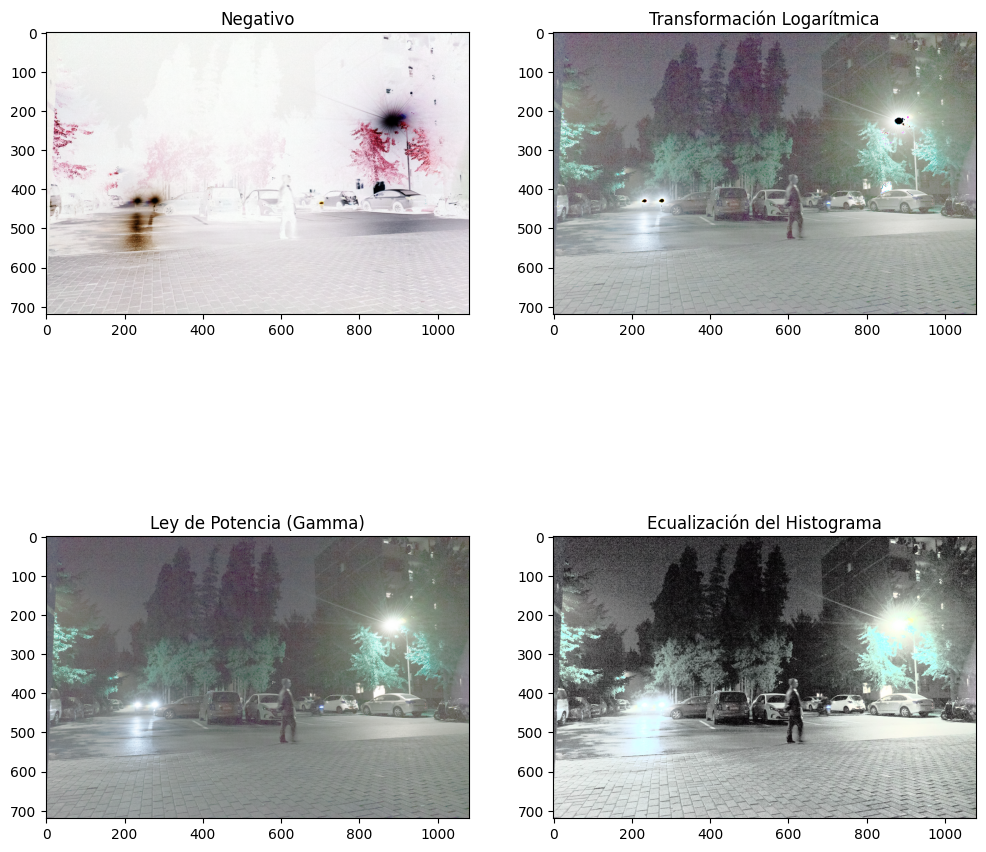

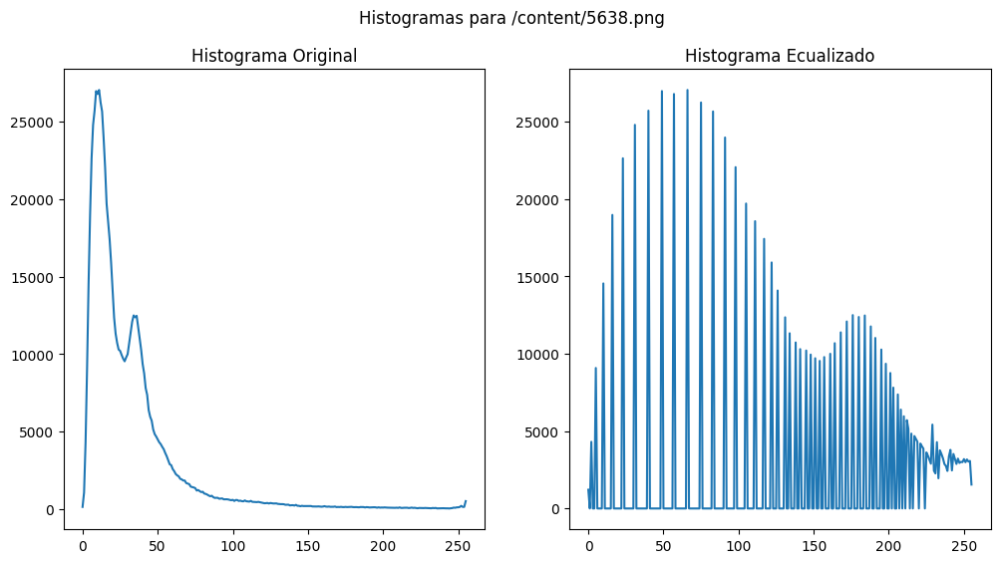

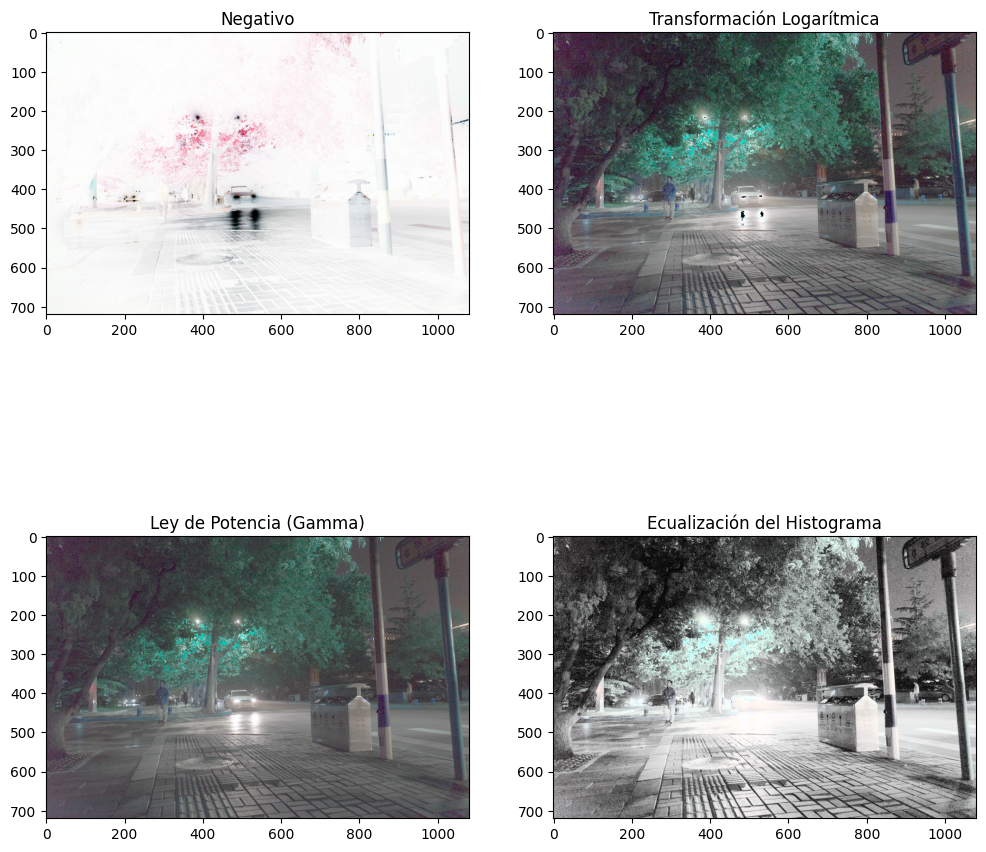

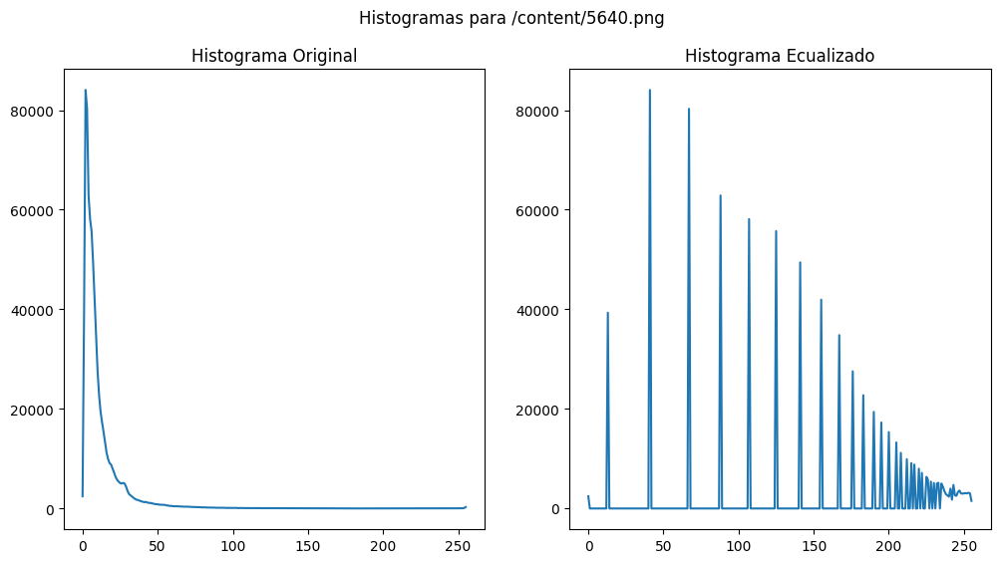

In [ ]:
# Función para aplicar el negativo de una imagen
def negative_image(image):
    return 255 - image

# Función para aplicar la transformación logarítmica
def log_transform(image):
    c = 255 / np.log(1 + np.max(image))
    log_image = c * (np.log(image + 1))
    log_image = np.array(log_image, dtype=np.uint8)
    return log_image

# Función para aplicar la ley de potencia (gamma correction)
def gamma_transform(image, gamma):
    gamma_corrected = exposure.adjust_gamma(image, gamma)
    return gamma_corrected

# Función para ecualizar el histograma
def histogram_equalization(image):
    img_yuv = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
    original_hist = cv2.calcHist([img_yuv[:, :, 0]], [0], None, [256], [0, 256])

    img_yuv[:, :, 0] = cv2.equalizeHist(img_yuv[:, :, 0])
    equalized = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)
    equalized_hist = cv2.calcHist([img_yuv[:, :, 0]], [0], None, [256], [0, 256])

    return equalized, original_hist, equalized_hist

def plot_histograms(original_hist, equalized_hist, image_path):
    plt.figure(figsize=(12, 6))
    plt.subplot(121), plt.plot(original_hist), plt.title('Histograma Original')
    plt.subplot(122), plt.plot(equalized_hist), plt.title('Histograma Ecualizado')
    plt.suptitle(f"Histogramas para {image_path}")
    plt.show()

# Aplicar las técnicas a cada imagen
for image, path in zip(images, image_paths):
    negative = negative_image(image)
    log_image = log_transform(image)
    gamma_image = gamma_transform(image, gamma=0.3)
    equalized_image, original_hist, equalized_hist = histogram_equalization(image)

    # Mostrar resultados
    plt.figure(figsize=(12, 12))
    plt.subplot(221), plt.imshow(negative), plt.title('Negativo')
    plt.subplot(222), plt.imshow(log_image), plt.title('Transformación Logarítmica')
    plt.subplot(223), plt.imshow(gamma_image), plt.title('Ley de Potencia (Gamma)')
    plt.subplot(224), plt.imshow(equalized_image), plt.title('Ecualización del Histograma')
    plt.show()

    # Mostrar histogramas
    plot_histograms(original_hist, equalized_hist, path)


<ipython-input-3-7419f102667e>:8: RuntimeWarning: divide by zero encountered in log
  log_image = c * (np.log(image + 1))
<ipython-input-3-7419f102667e>:9: RuntimeWarning: invalid value encountered in cast
  log_image = np.array(log_image, dtype=np.uint8)


Comparaciones para /content/5393.png


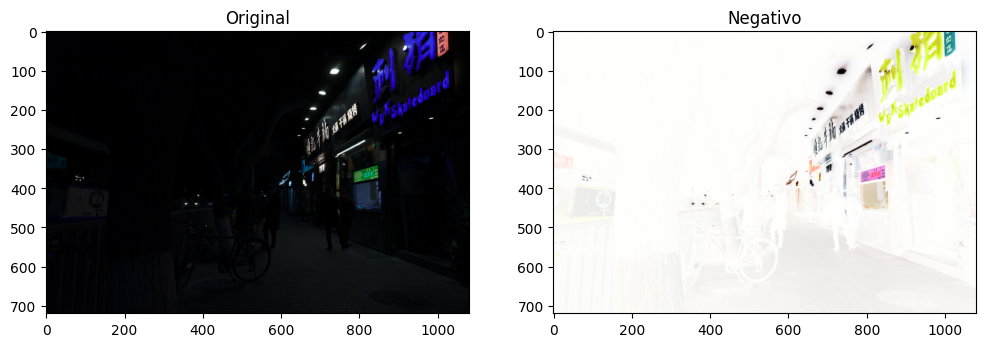

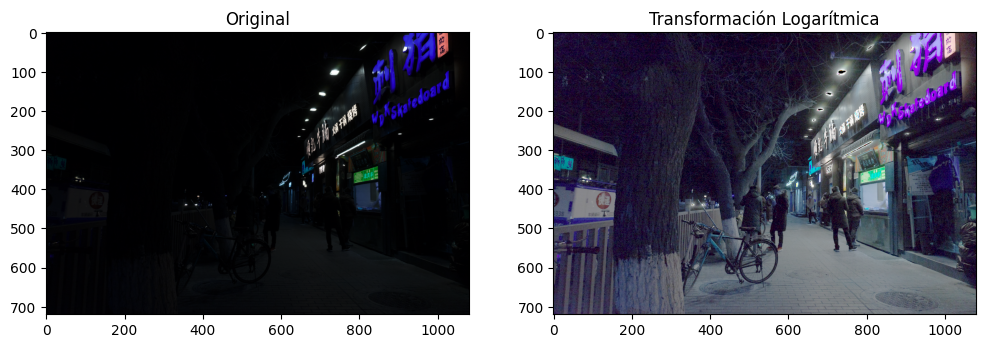

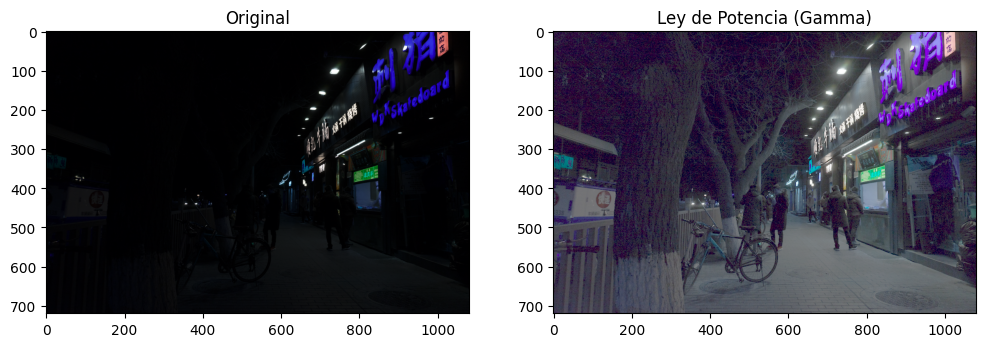

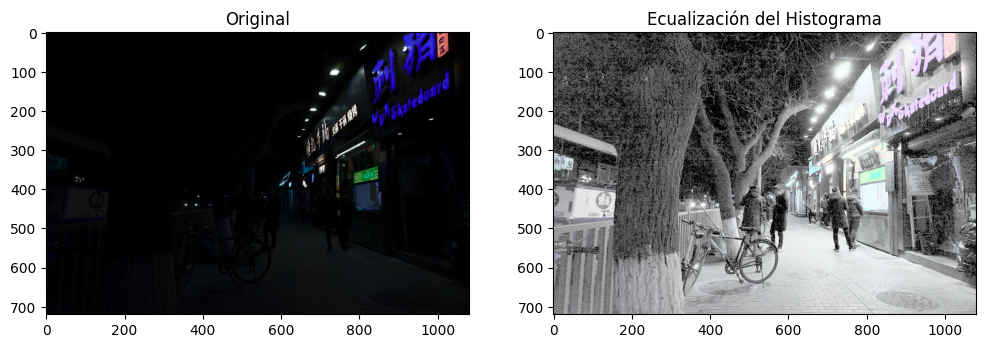

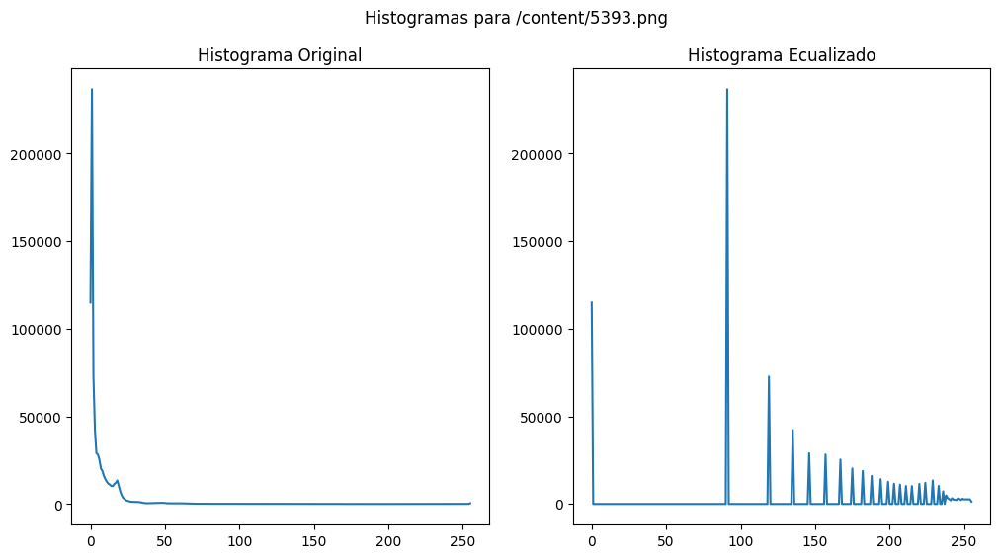

Comparaciones para /content/5404.png


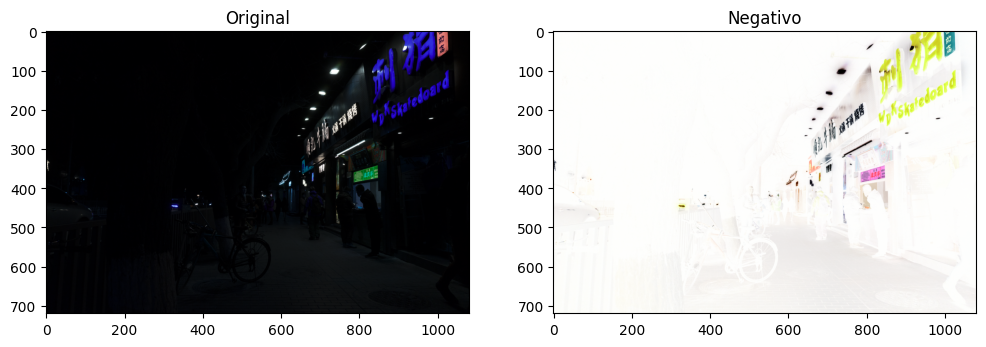

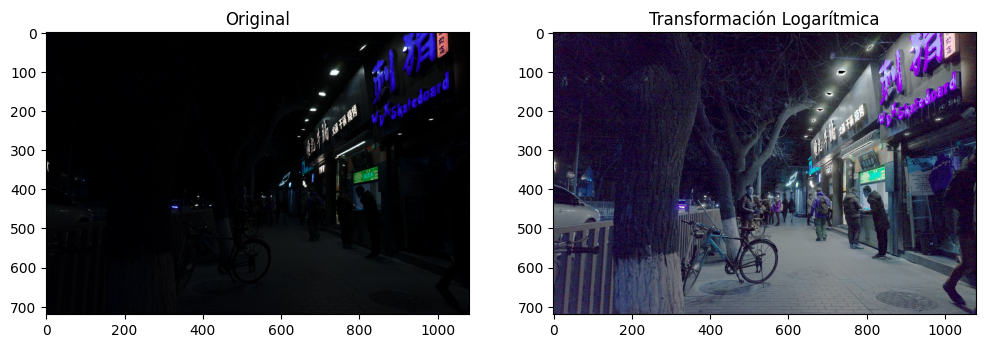

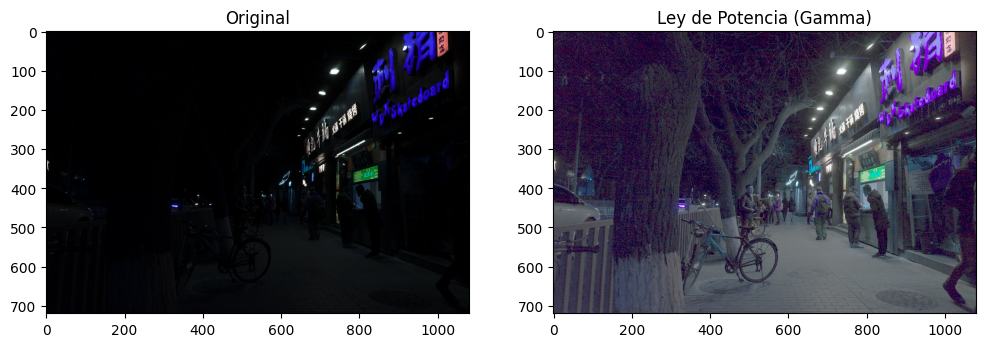

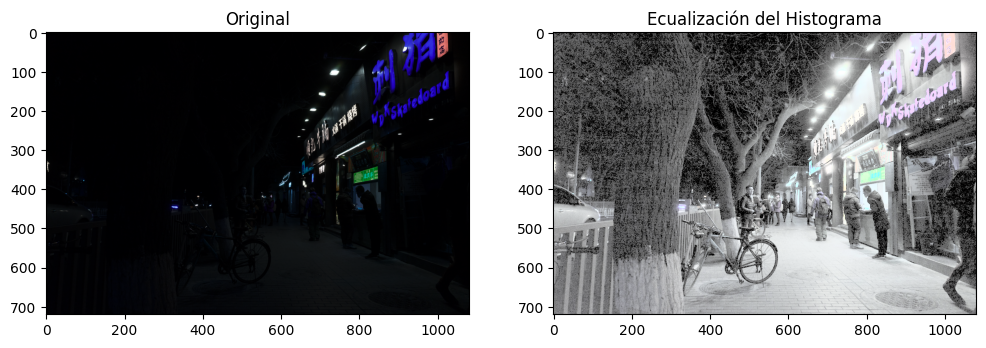

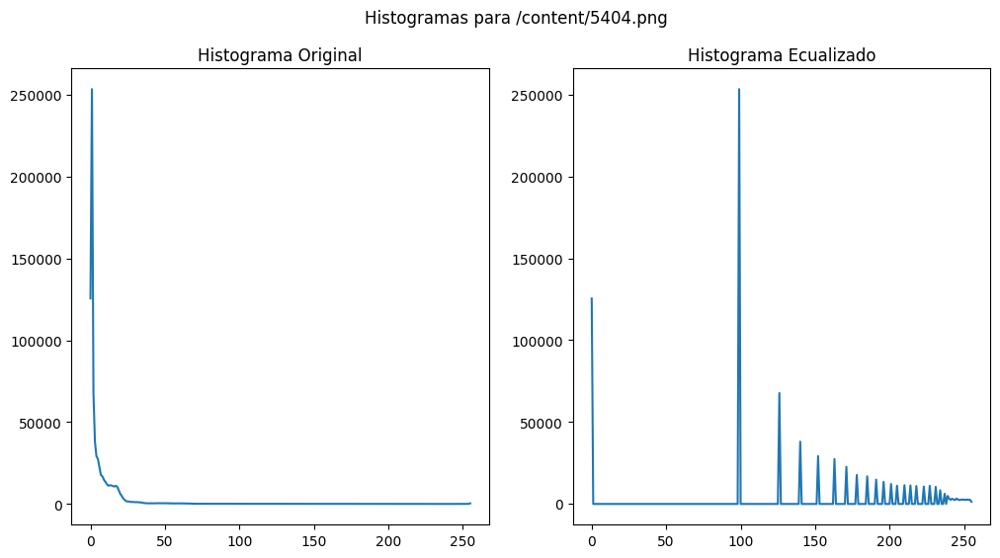

Comparaciones para /content/5638.png


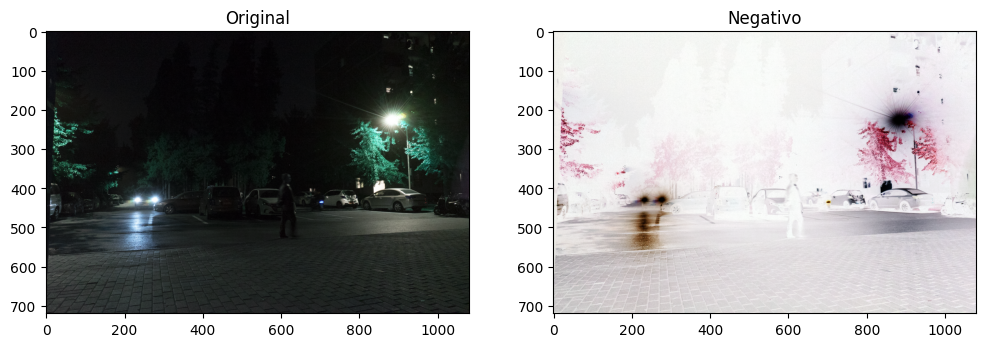

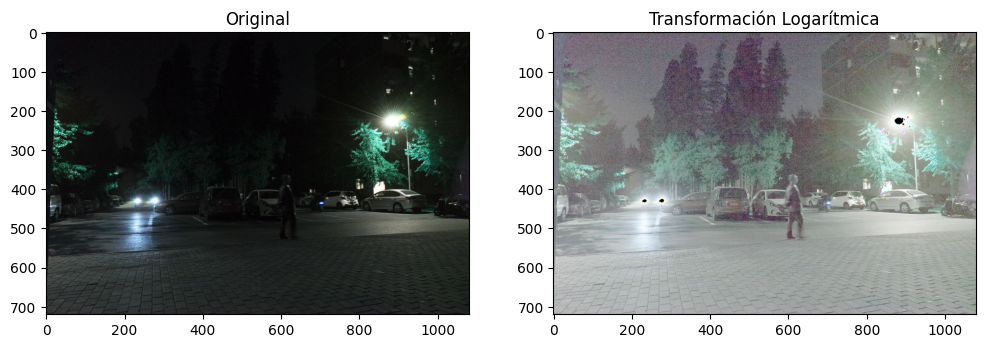

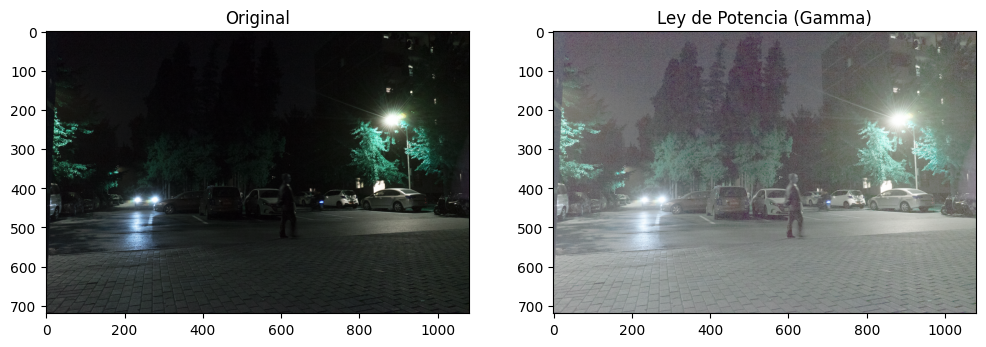

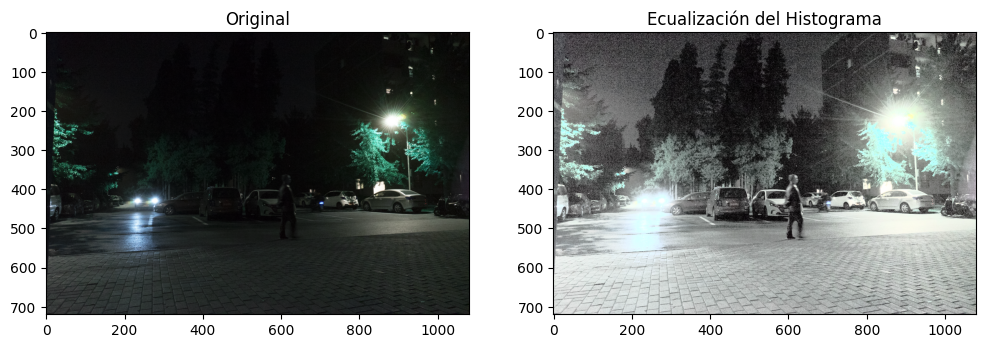

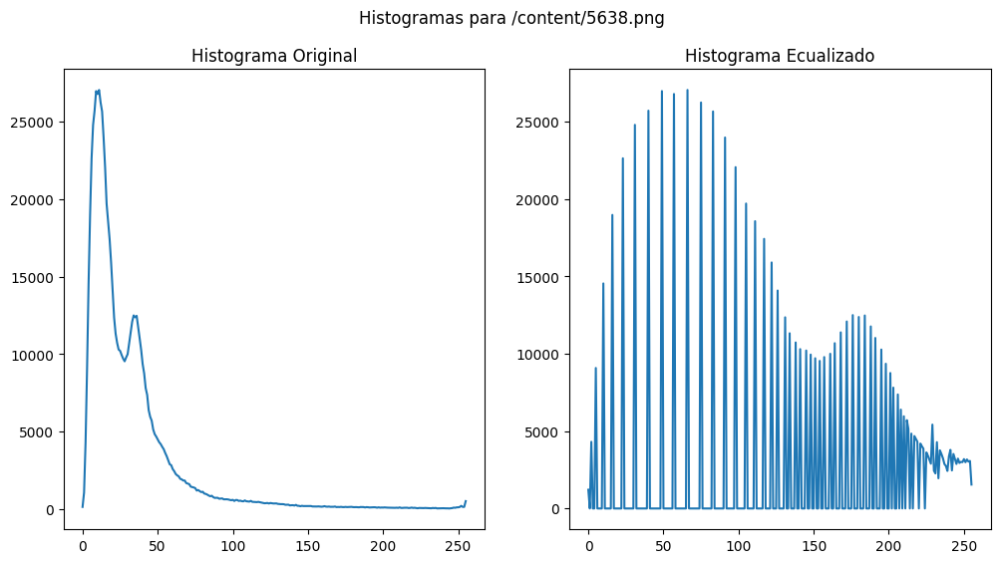

Comparaciones para /content/5640.png


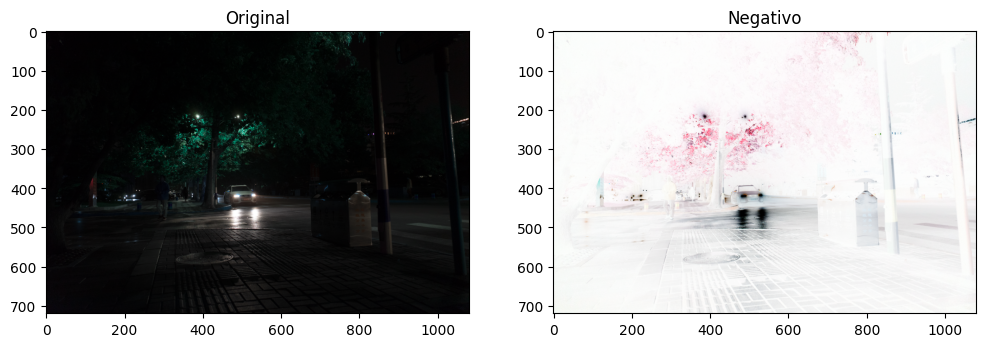

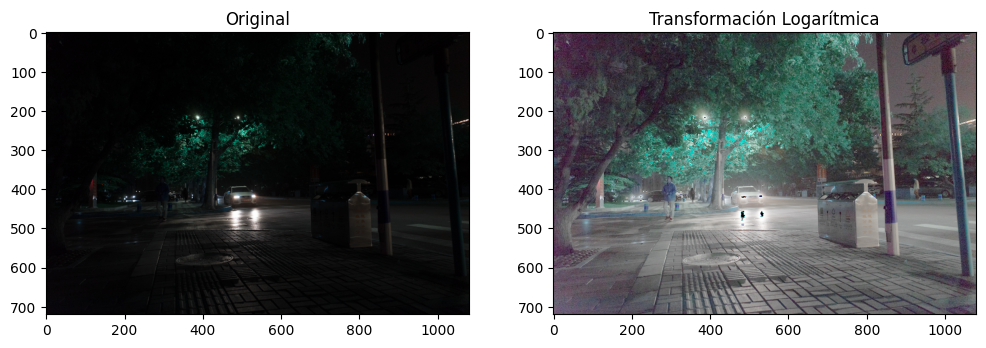

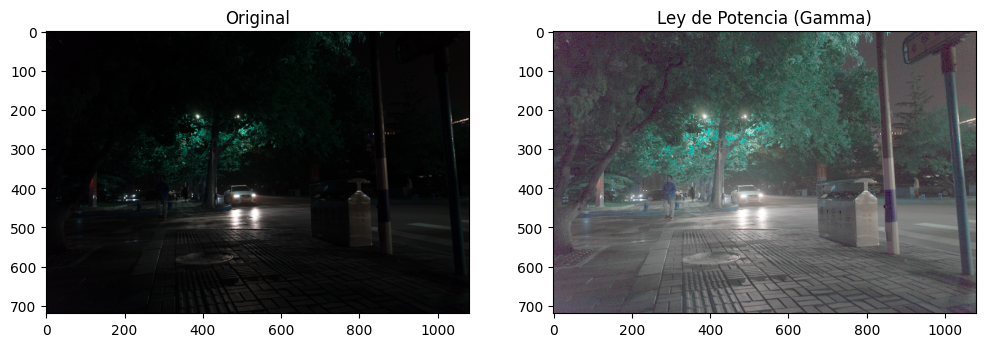

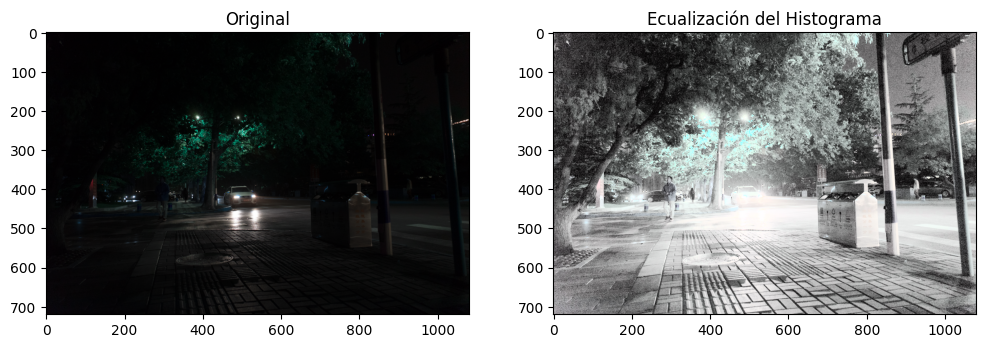

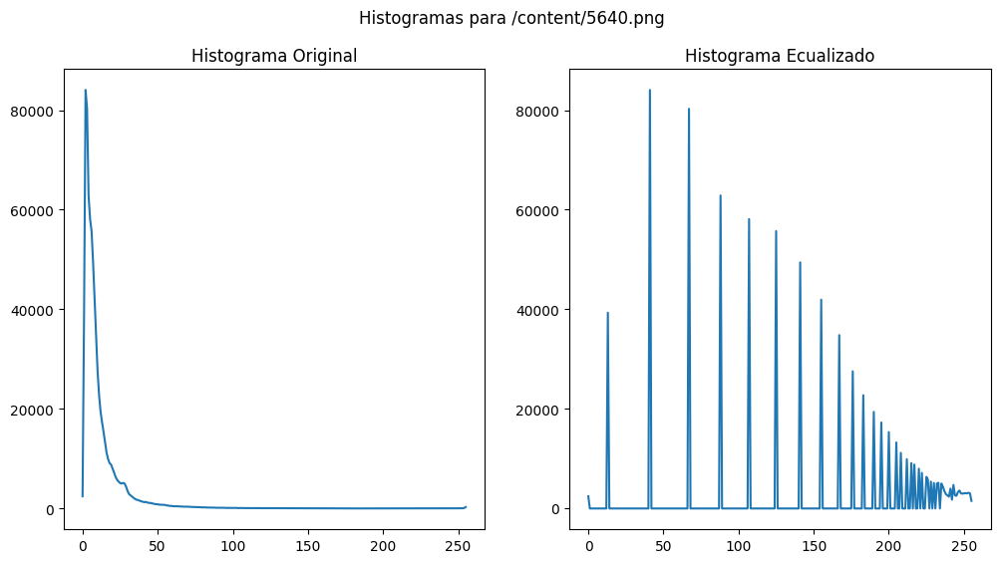

In [ ]:
# Función para mostrar la comparación de la imagen original y las mejoradas
def compare_images(original, processed, title):
    plt.figure(figsize=(12, 6))
    plt.subplot(121), plt.imshow(original, cmap='gray'), plt.title('Original')
    plt.subplot(122), plt.imshow(processed, cmap='gray'), plt.title(title)
    plt.show()

# Comparar imágenes originales con las mejoradas
for image, path in zip(images, image_paths):
    negative = negative_image(image)
    log_image = log_transform(image)
    gamma_image = gamma_transform(image, gamma=0.3)
    # equalized_image = histogram_equalization(image)
    equalized_image, original_hist, equalized_hist = histogram_equalization(image)


    print(f"Comparaciones para {path}")
    compare_images(image, negative, 'Negativo')
    compare_images(image, log_image, 'Transformación Logarítmica')
    compare_images(image, gamma_image, 'Ley de Potencia (Gamma)')
    compare_images(image, equalized_image, 'Ecualización del Histograma')

    plot_histograms(original_hist, equalized_hist, path)


BLANCO Y NEGRO


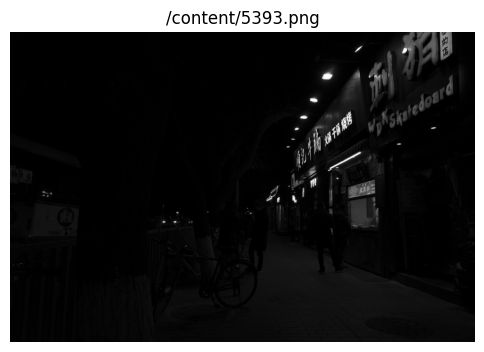

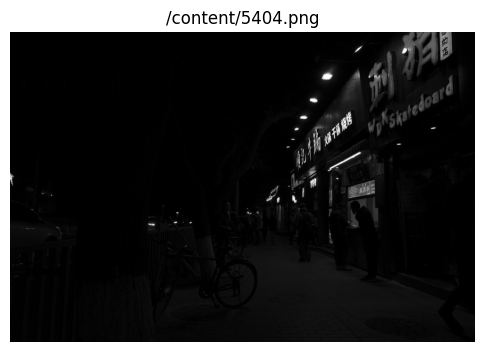

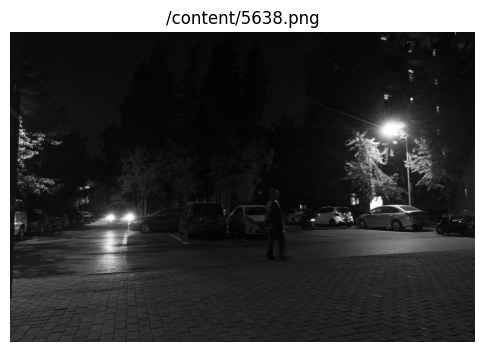

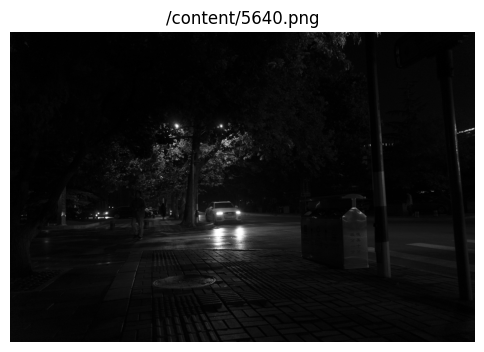

In [ ]:
# Importar librerías necesarias
import cv2
import numpy as np
from matplotlib import pyplot as plt
from skimage import exposure

# Función para cargar y mostrar imágenes
def load_and_display_image(path):
    # b/n
    image = cv2.imread(path, cv2.IMREAD_GRAYSCALE)

    # COLOR
    #image = cv2.imread(path)
    #image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    plt.title(path)
    plt.axis('off')
    plt.show()
    return image

# Cargar y mostrar las imágenes
image_paths = ["/content/5393.png", "/content/5404.png", "/content/5638.png", "/content/5640.png"]
images = [load_and_display_image(path) for path in image_paths]

<ipython-input-6-1b03a2483ce2>:8: RuntimeWarning: divide by zero encountered in log
  log_image = c * (np.log(image + 1))
<ipython-input-6-1b03a2483ce2>:9: RuntimeWarning: invalid value encountered in cast
  log_image = np.array(log_image, dtype=np.uint8)


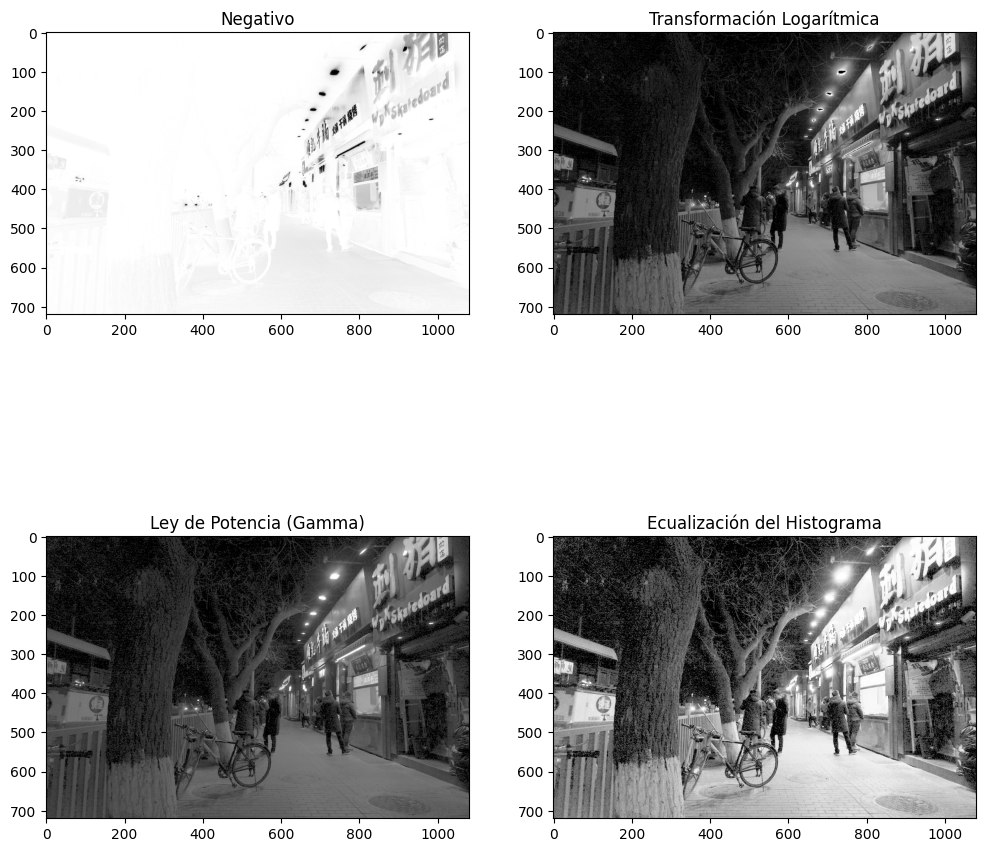

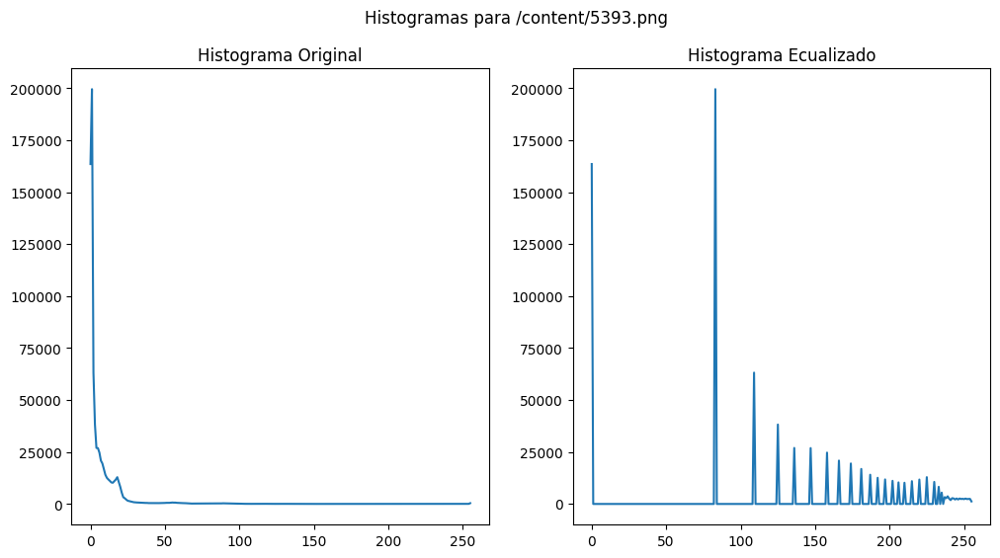

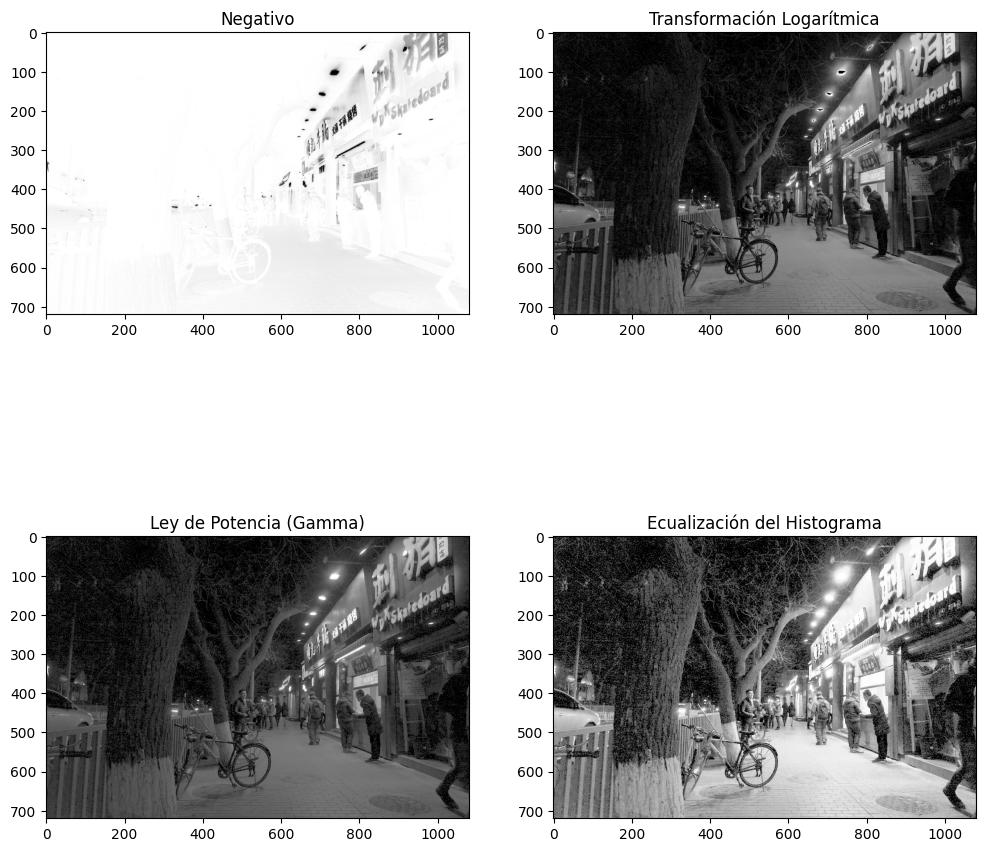

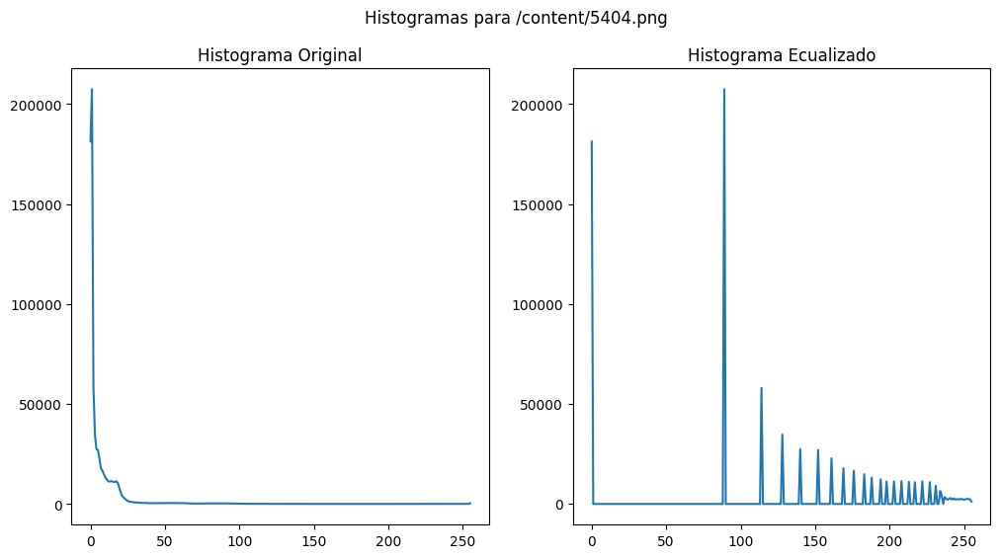

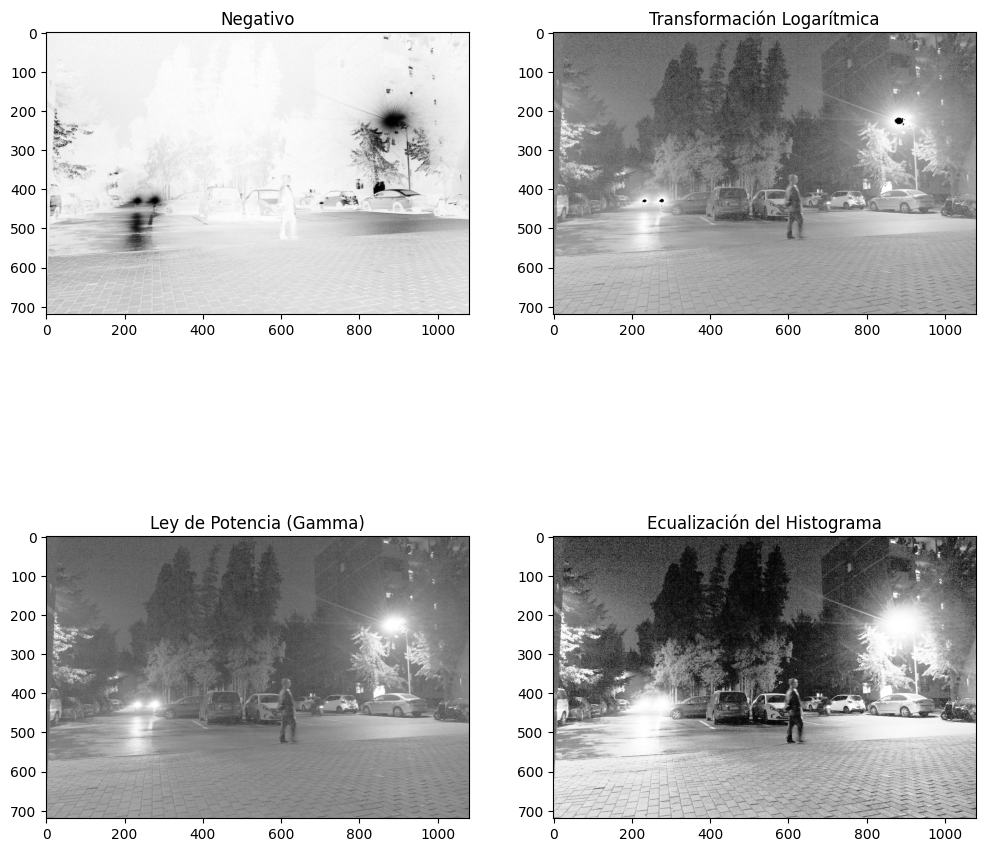

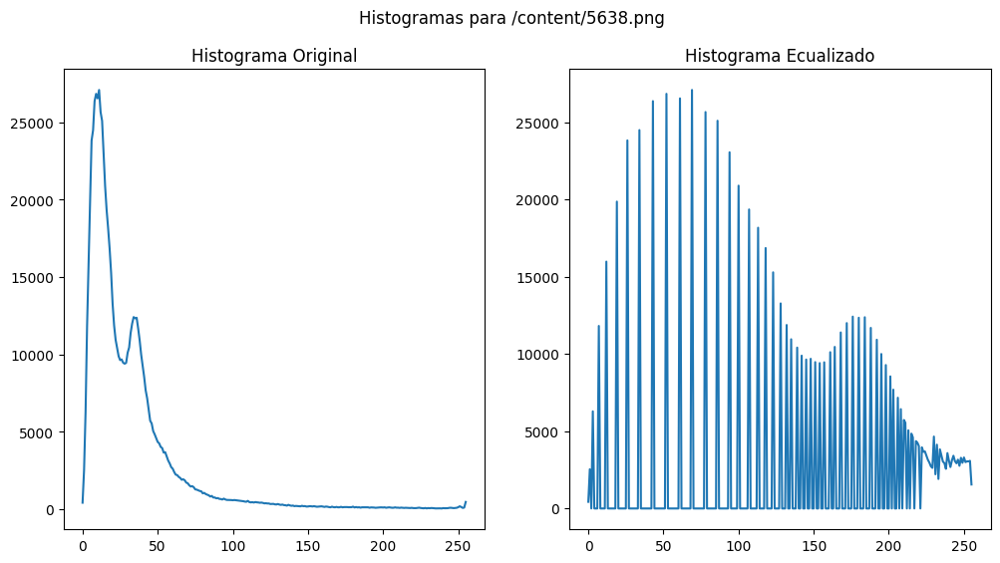

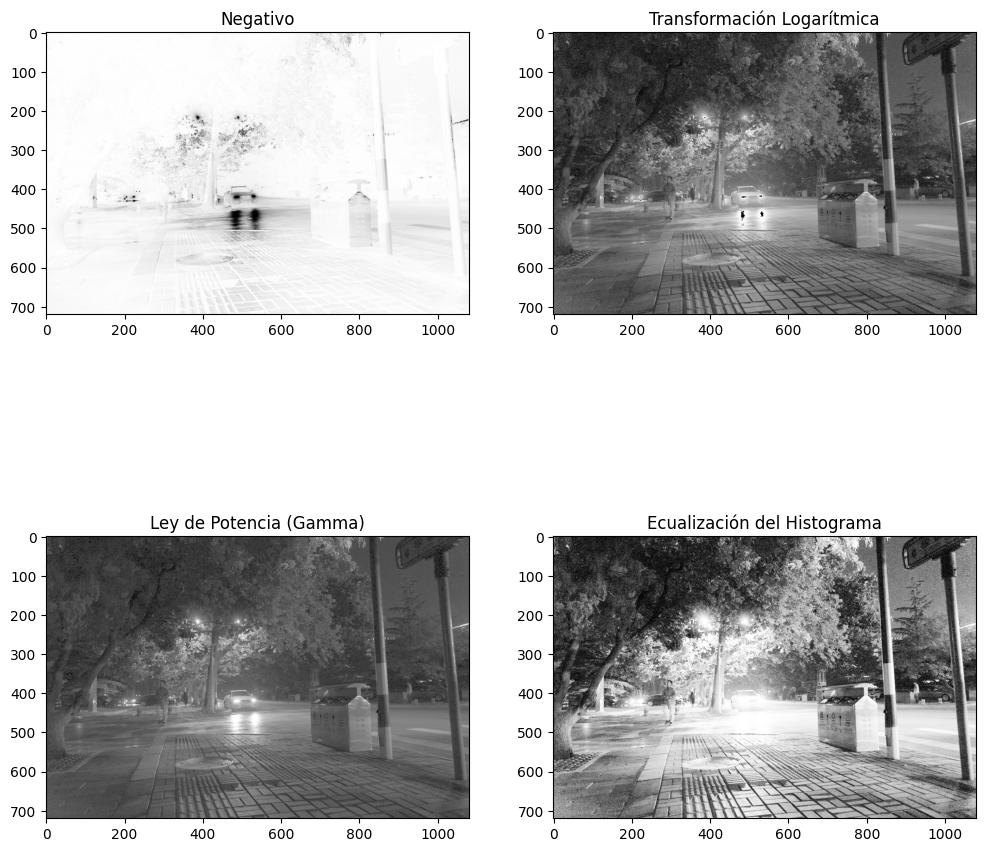

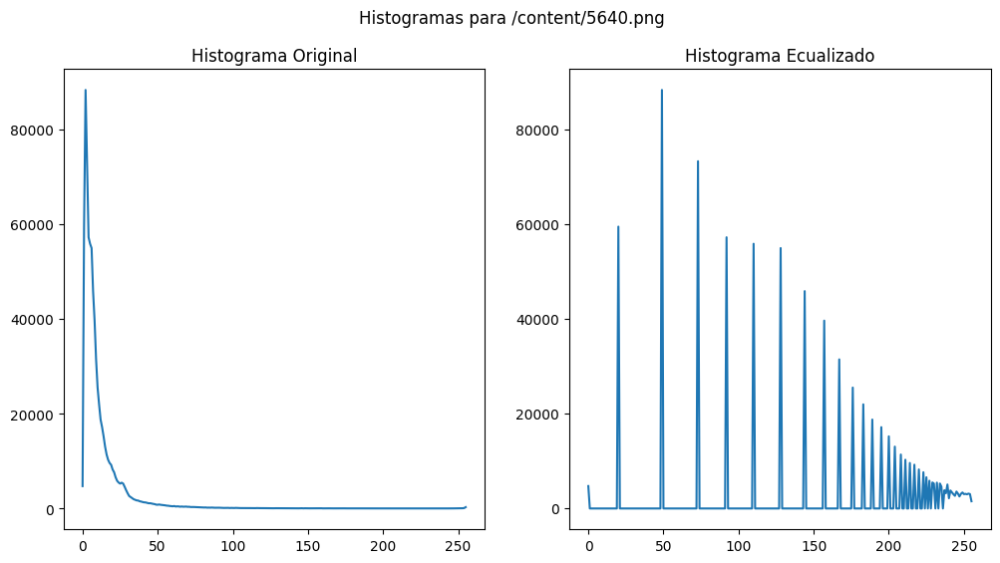

In [ ]:
# Función para aplicar el negativo de una imagen
def negative_image(image):
    return 255 - image

# Función para aplicar la transformación logarítmica
def log_transform(image):
    c = 255 / np.log(1 + np.max(image))
    log_image = c * (np.log(image + 1))
    log_image = np.array(log_image, dtype=np.uint8)
    return log_image

# Función para aplicar la ley de potencia (gamma correction)
def gamma_transform(image, gamma):
    gamma_corrected = exposure.adjust_gamma(image, gamma)
    return gamma_corrected

# Función para ecualizar el histograma y mostrar los histogramas antes y después
def histogram_equalization(image):
    original_hist = cv2.calcHist([image], [0], None, [256], [0, 256])
    equalized = cv2.equalizeHist(image)
    equalized_hist = cv2.calcHist([equalized], [0], None, [256], [0, 256])
    return equalized, original_hist, equalized_hist

# Función para mostrar los histogramas
def plot_histograms(original_hist, equalized_hist, image_path):
    plt.figure(figsize=(12, 6))
    plt.subplot(121), plt.plot(original_hist), plt.title('Histograma Original')
    plt.subplot(122), plt.plot(equalized_hist), plt.title('Histograma Ecualizado')
    plt.suptitle(f"Histogramas para {image_path}")
    plt.show()

# Aplicar las técnicas a cada imagen
for image, path in zip(images, image_paths):
    negative = negative_image(image)
    log_image = log_transform(image)
    gamma_image = gamma_transform(image, gamma=0.3)
    equalized_image, original_hist, equalized_hist = histogram_equalization(image)

    # Mostrar resultados
    plt.figure(figsize=(12, 12))
    plt.subplot(221), plt.imshow(negative, cmap='gray'), plt.title('Negativo')
    plt.subplot(222), plt.imshow(log_image, cmap='gray'), plt.title('Transformación Logarítmica')
    plt.subplot(223), plt.imshow(gamma_image, cmap='gray'), plt.title('Ley de Potencia (Gamma)')
    plt.subplot(224), plt.imshow(equalized_image, cmap='gray'), plt.title('Ecualización del Histograma')
    plt.show()

    # Mostrar histogramas
    plot_histograms(original_hist, equalized_hist, path)

<ipython-input-6-1b03a2483ce2>:8: RuntimeWarning: divide by zero encountered in log
  log_image = c * (np.log(image + 1))
<ipython-input-6-1b03a2483ce2>:9: RuntimeWarning: invalid value encountered in cast
  log_image = np.array(log_image, dtype=np.uint8)


Comparaciones para /content/5393.png


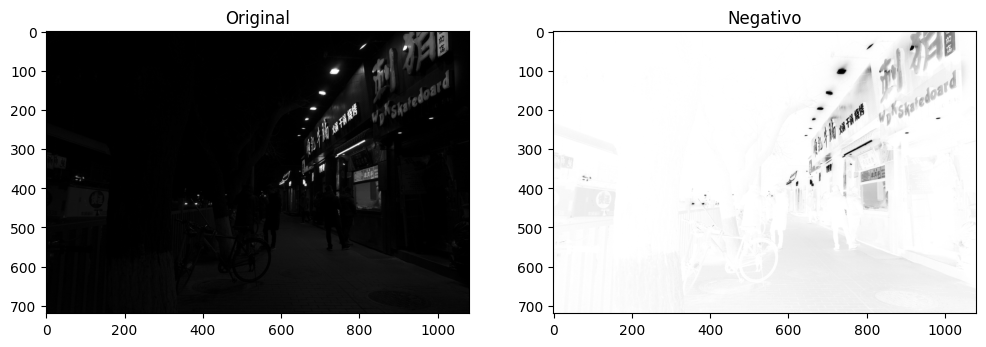

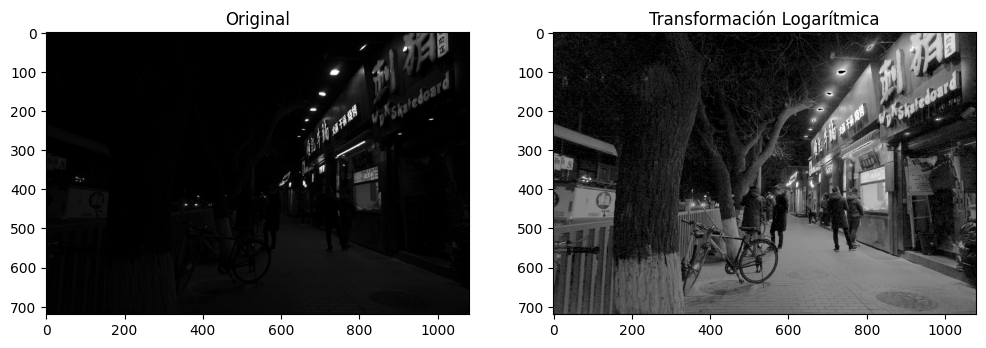

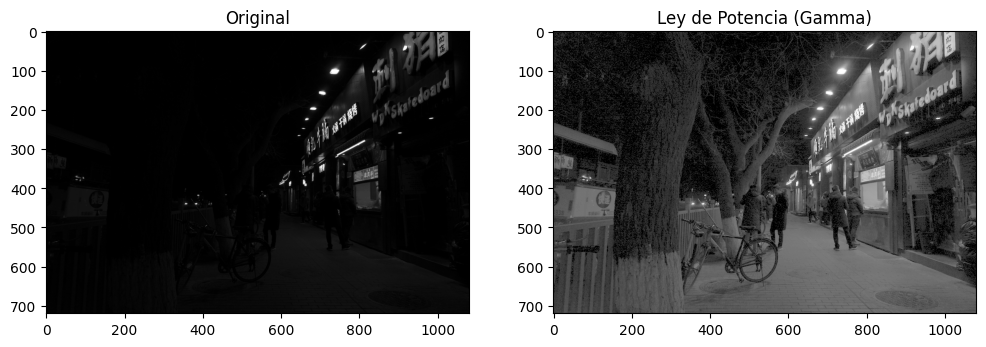

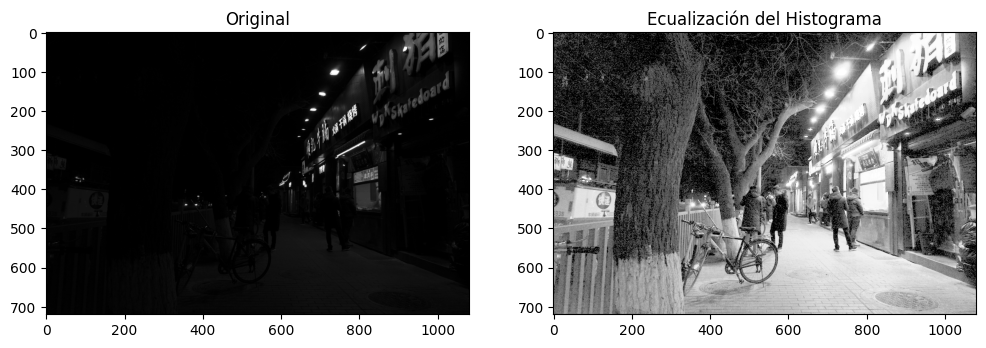

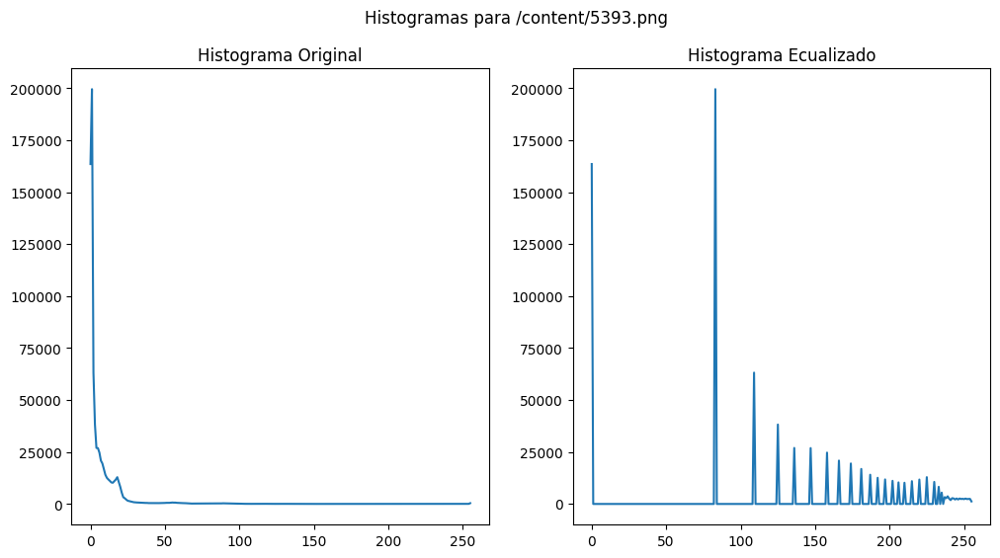

Comparaciones para /content/5404.png


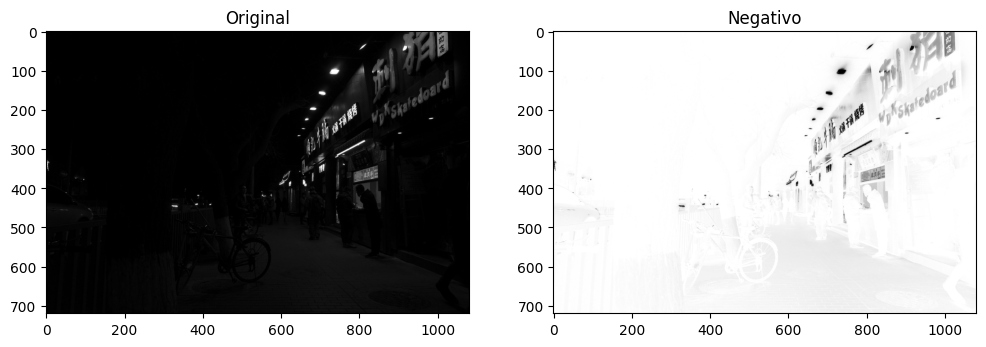

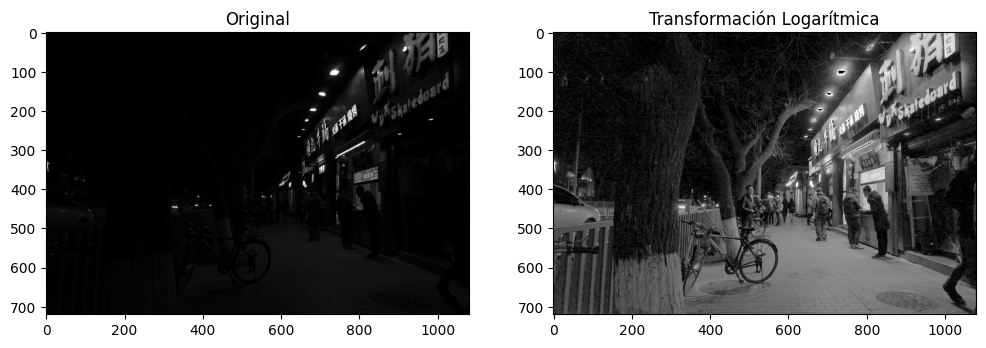

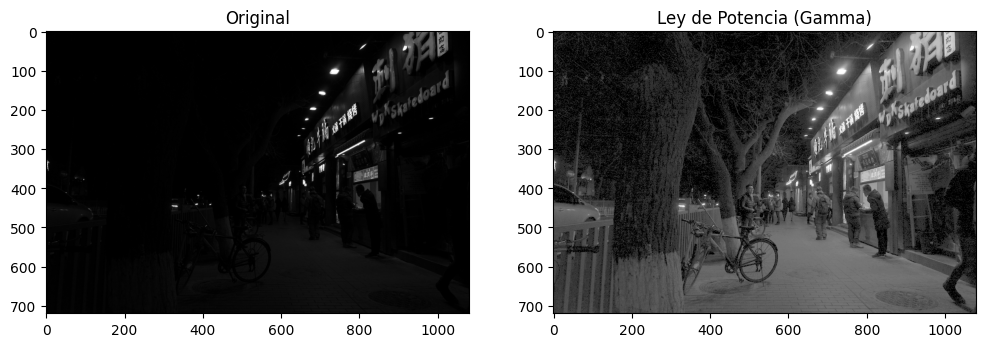

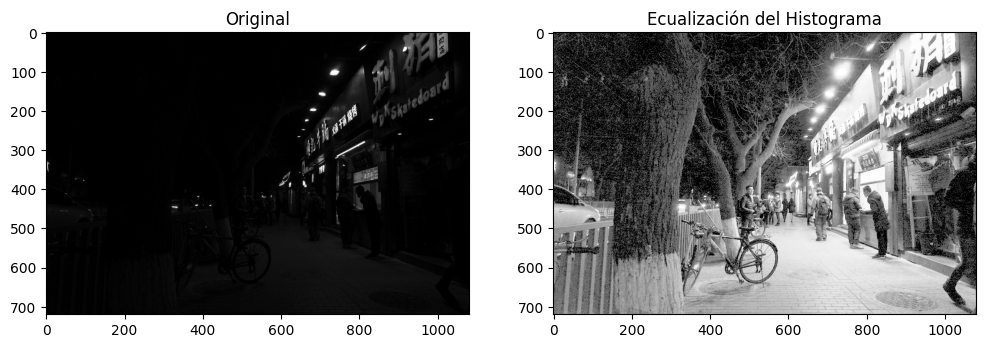

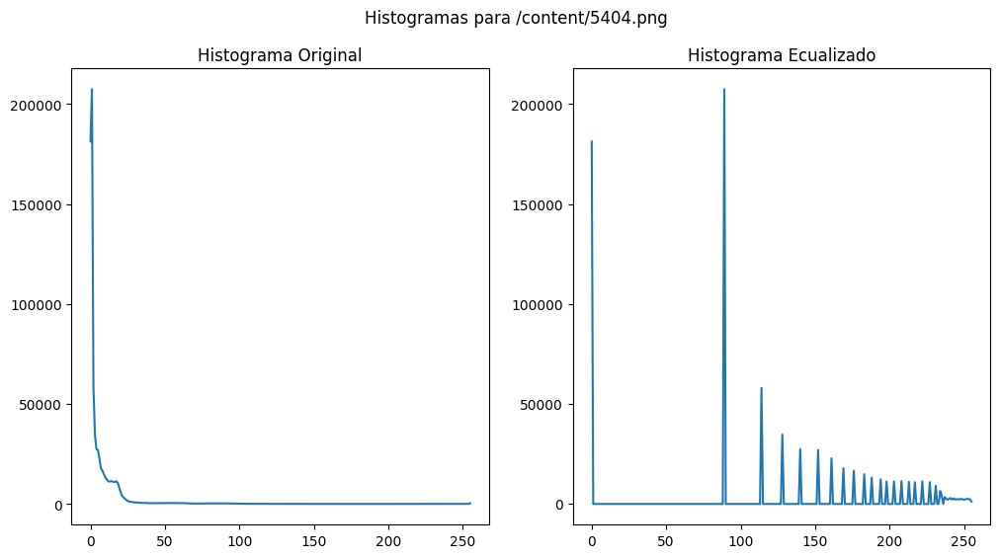

Comparaciones para /content/5638.png


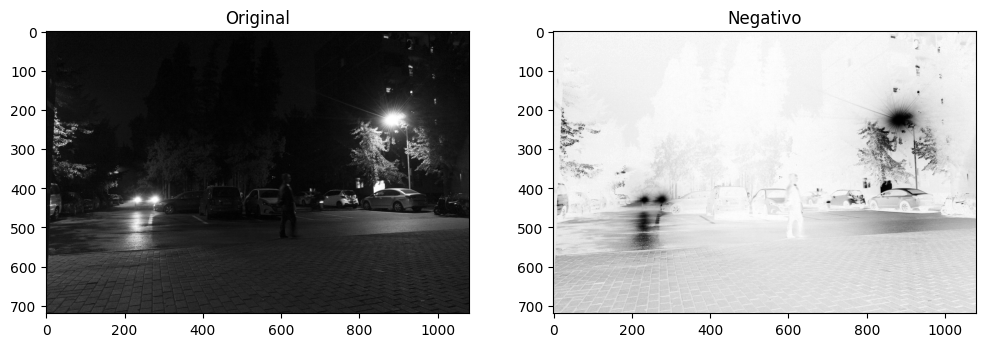

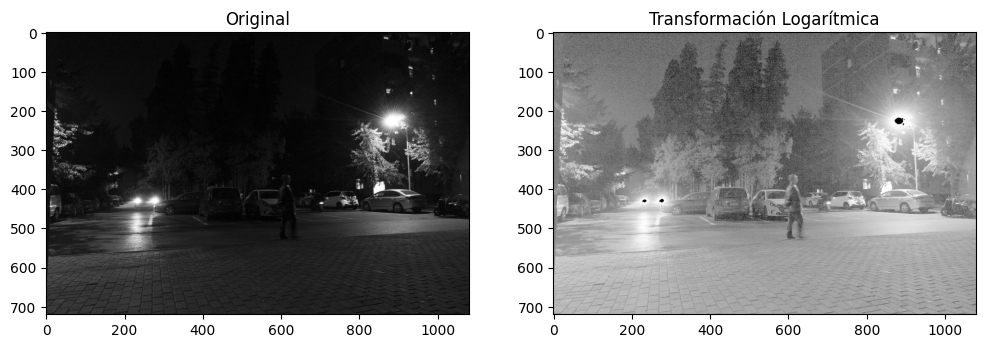

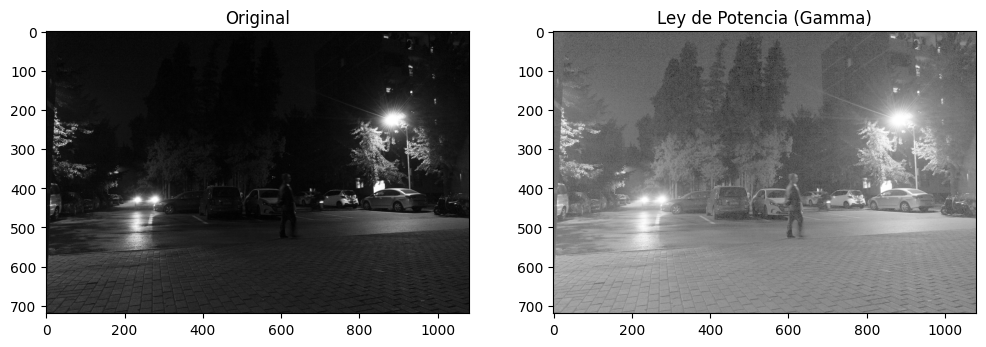

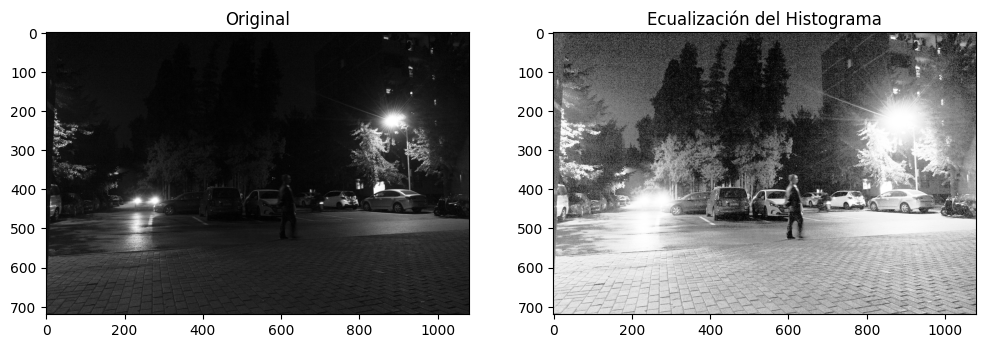

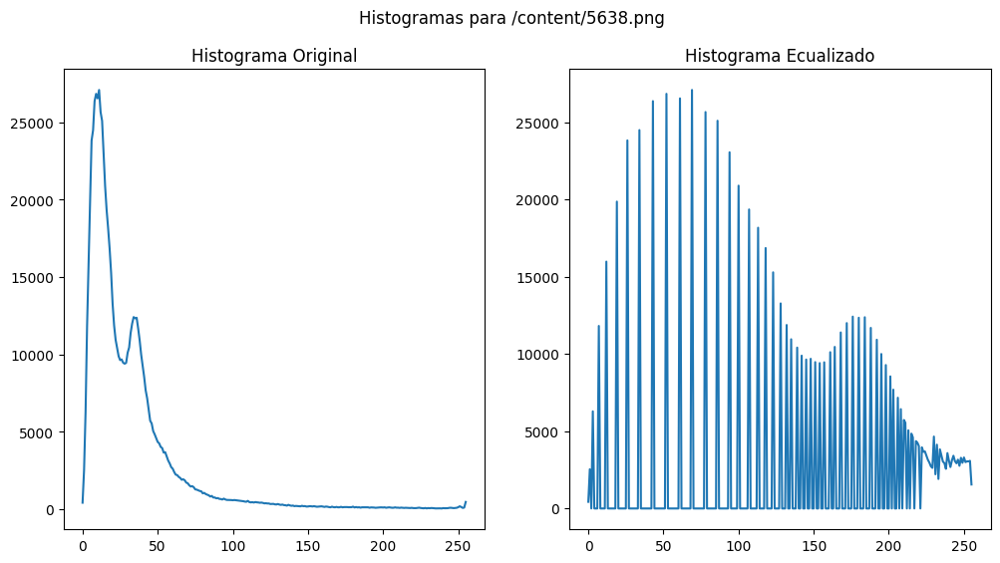

Comparaciones para /content/5640.png


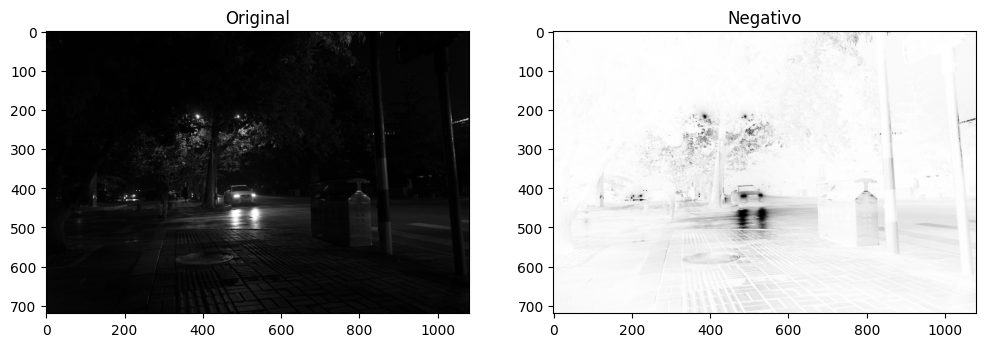

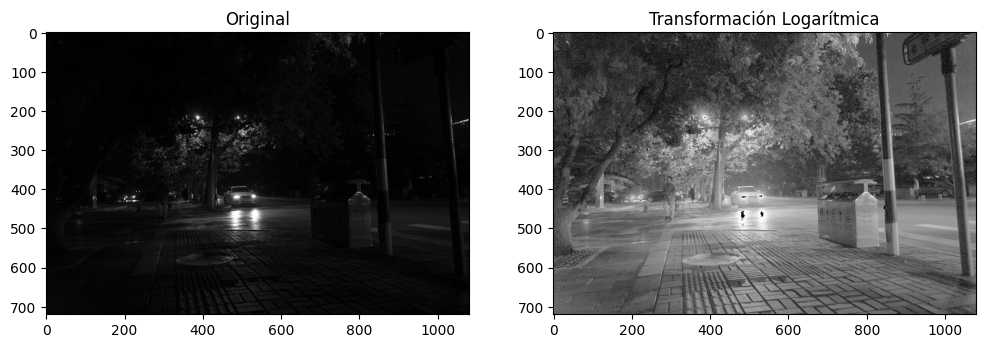

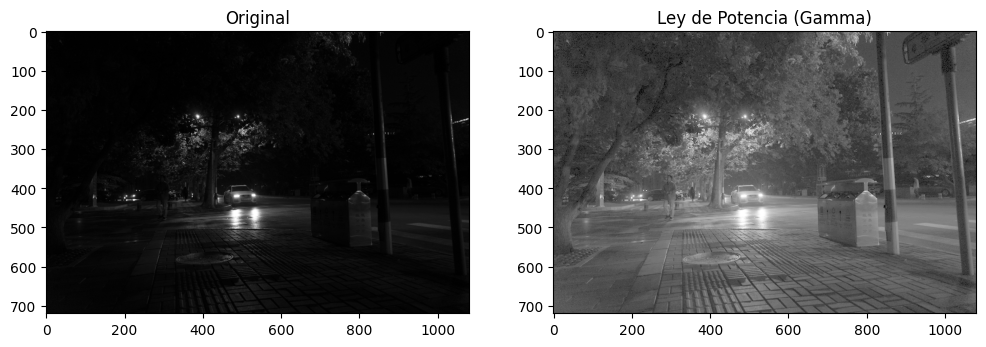

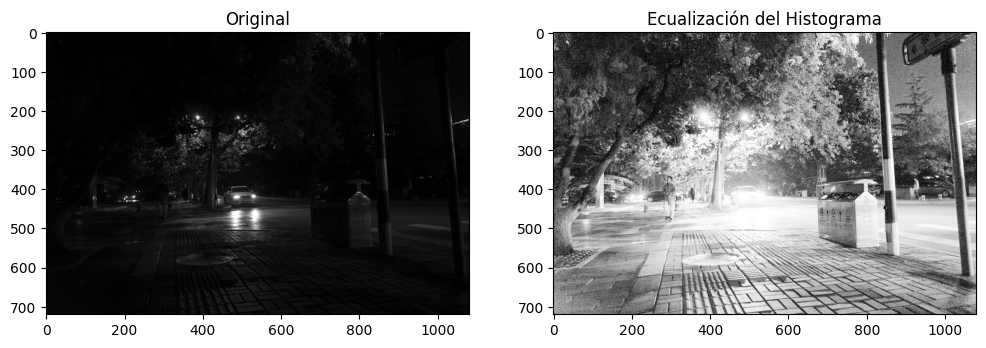

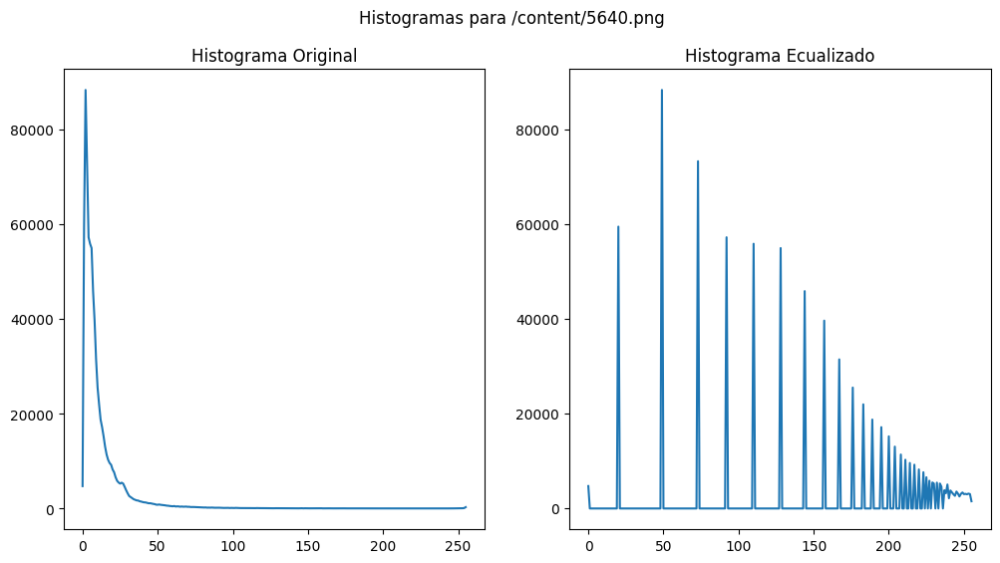

In [ ]:
# Función para mostrar la comparación de la imagen original y las mejoradas
def compare_images(original, processed, title):
    plt.figure(figsize=(12, 6))
    plt.subplot(121), plt.imshow(original, cmap='gray'), plt.title('Original')
    plt.subplot(122), plt.imshow(processed, cmap='gray'), plt.title(title)
    plt.show()

# Comparar imágenes originales con las mejoradas
for image, path in zip(images, image_paths):
    negative = negative_image(image)
    log_image = log_transform(image)
    gamma_image = gamma_transform(image, gamma=0.3)
    equalized_image, original_hist, equalized_hist = histogram_equalization(image)

    print(f"Comparaciones para {path}")
    compare_images(image, negative, 'Negativo')
    compare_images(image, log_image, 'Transformación Logarítmica')
    compare_images(image, gamma_image, 'Ley de Potencia (Gamma)')
    compare_images(image, equalized_image, 'Ecualización del Histograma')

    # Mostrar histogramas
    plot_histograms(original_hist, equalized_hist, path)

Operaciones Aritméticas

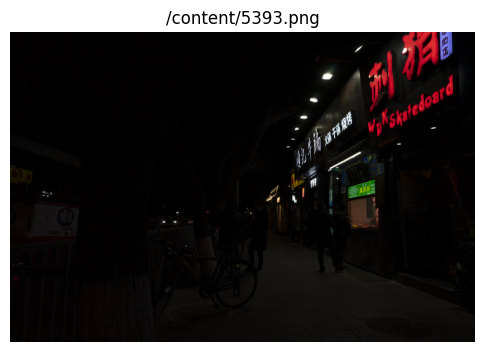

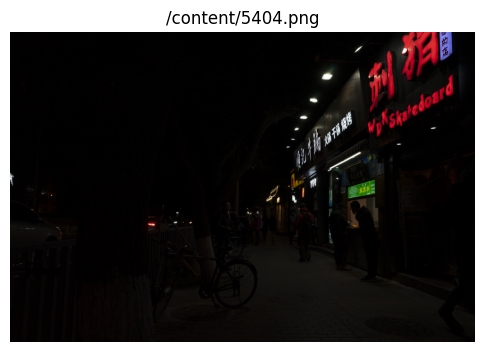

In [ ]:
# Importar librerías necesarias
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Función para cargar y mostrar imágenes
def load_and_display_image(path):
    image = cv2.imread(path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(6, 6))
    plt.imshow(image_rgb)
    plt.title(path)
    plt.axis('off')
    plt.show()
    return image_rgb

# Cargar y mostrar las imágenes
image1_path = "/content/5393.png"
image2_path = "/content/5404.png"
image1 = load_and_display_image(image1_path)
image2 = load_and_display_image(image2_path)


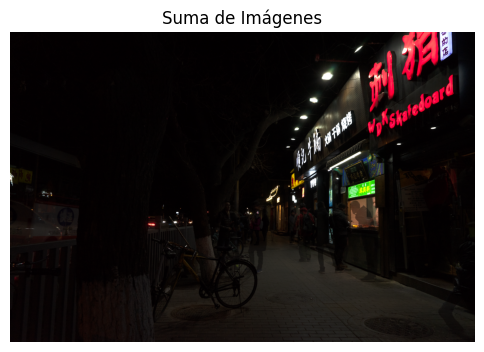

In [ ]:
# Función para sumar dos imágenes
def add_images(image1, image2):
    added_image = cv2.add(image1, image2)
    return added_image

# Sumar las imágenes
added_image = add_images(image1, image2)

# Mostrar resultado de la suma
plt.figure(figsize=(6, 6))
plt.imshow(added_image)
plt.title('Suma de Imágenes')
plt.axis('off')
plt.show()


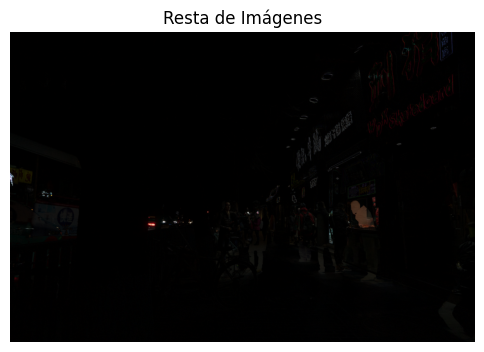

In [ ]:
# Función para restar dos imágenes
def subtract_images(image1, image2):
    subtracted_image = cv2.absdiff(image1, image2)
    return subtracted_image

# Restar las imágenes
subtracted_image = subtract_images(image1, image2)

# Mostrar resultado de la resta
plt.figure(figsize=(6, 6))
plt.imshow(subtracted_image)
plt.title('Resta de Imágenes')
plt.axis('off')
plt.show()


Comparación de Suma de Imágenes


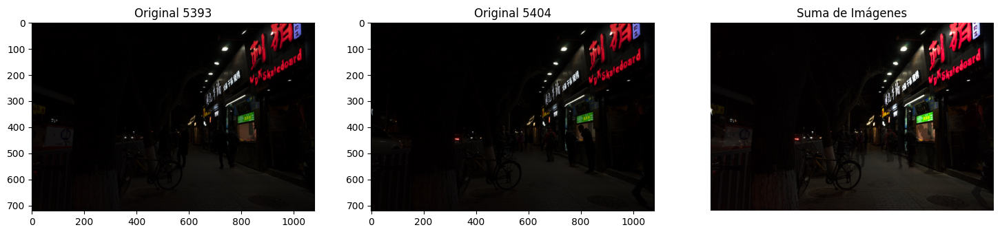

Comparación de Resta de Imágenes


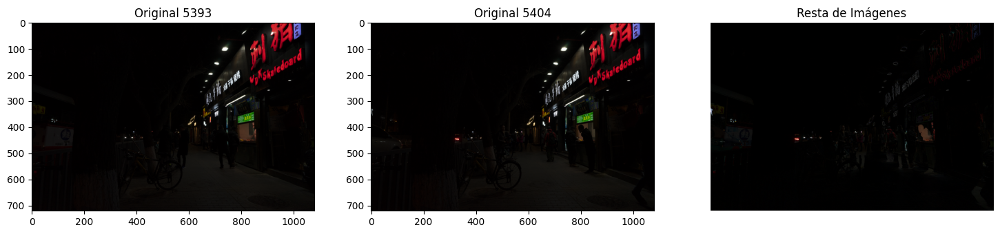

In [ ]:
# Función para mostrar la comparación de la imagen original y las procesadas
def compare_images(original1, original2, processed, title):
    plt.figure(figsize=(18, 6))
    plt.subplot(131), plt.imshow(original1), plt.title('Original 5393')
    plt.subplot(132), plt.imshow(original2), plt.title('Original 5404')
    plt.subplot(133), plt.imshow(processed), plt.title(title)
    plt.axis('off')
    plt.show()

# Comparar las imágenes originales con los resultados de las operaciones aritméticas
print("Comparación de Suma de Imágenes")
compare_images(image1, image2, added_image, 'Suma de Imágenes')

print("Comparación de Resta de Imágenes")
compare_images(image1, image2, subtracted_image, 'Resta de Imágenes')


Operaciones aritmeticas B/N

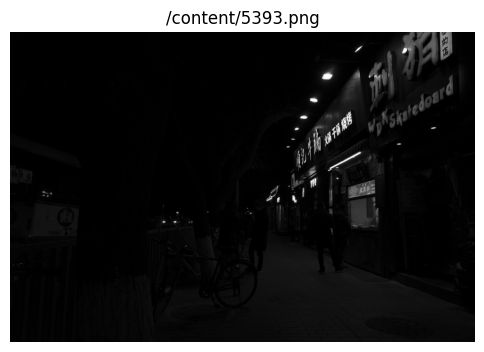

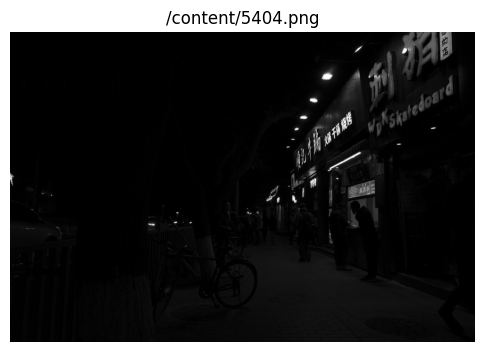

In [ ]:
# Importar librerías necesarias
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Función para cargar y mostrar imágenes en escala de grises
def load_and_display_image_gray(path):
    image = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    plt.title(path)
    plt.axis('off')
    plt.show()
    return image

# Cargar y mostrar las imágenes en escala de grises
image1_path = "/content/5393.png"
image2_path = "/content/5404.png"
image1_gray = load_and_display_image_gray(image1_path)
image2_gray = load_and_display_image_gray(image2_path)


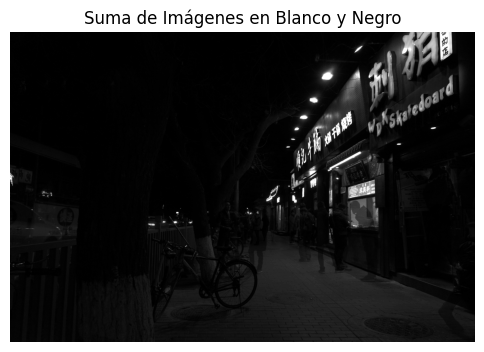

In [ ]:
# Función para sumar dos imágenes en escala de grises
def add_images(image1, image2):
    added_image = cv2.add(image1, image2)
    return added_image

# Sumar las imágenes
added_image_gray = add_images(image1_gray, image2_gray)

# Mostrar resultado de la suma
plt.figure(figsize=(6, 6))
plt.imshow(added_image_gray, cmap='gray')
plt.title('Suma de Imágenes en Blanco y Negro')
plt.axis('off')
plt.show()


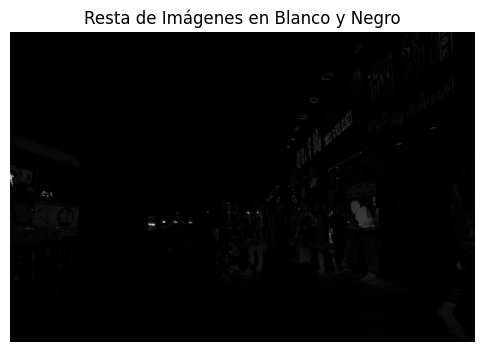

In [ ]:
# Función para restar dos imágenes en escala de grises
def subtract_images(image1, image2):
    subtracted_image = cv2.absdiff(image1, image2)
    return subtracted_image

# Restar las imágenes
subtracted_image_gray = subtract_images(image1_gray, image2_gray)

# Mostrar resultado de la resta
plt.figure(figsize=(6, 6))
plt.imshow(subtracted_image_gray, cmap='gray')
plt.title('Resta de Imágenes en Blanco y Negro')
plt.axis('off')
plt.show()


Comparación de Suma de Imágenes en Blanco y Negro


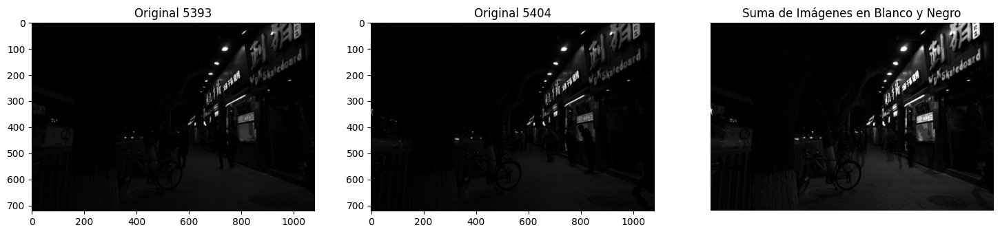

Comparación de Resta de Imágenes en Blanco y Negro


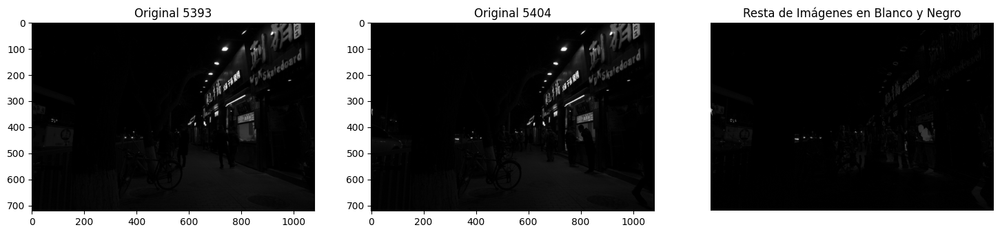

In [ ]:
# Función para mostrar la comparación de la imagen original y las procesadas
def compare_images(original1, original2, processed, title):
    plt.figure(figsize=(18, 6))
    plt.subplot(131), plt.imshow(original1, cmap='gray'), plt.title('Original 5393')
    plt.subplot(132), plt.imshow(original2, cmap='gray'), plt.title('Original 5404')
    plt.subplot(133), plt.imshow(processed, cmap='gray'), plt.title(title)
    plt.axis('off')
    plt.show()

# Comparar las imágenes originales con los resultados de las operaciones aritméticas
print("Comparación de Suma de Imágenes en Blanco y Negro")
compare_images(image1_gray, image2_gray, added_image_gray, 'Suma de Imágenes en Blanco y Negro')

print("Comparación de Resta de Imágenes en Blanco y Negro")
compare_images(image1_gray, image2_gray, subtracted_image_gray, 'Resta de Imágenes en Blanco y Negro')
